# Step 1 Import all essential libraries

In [20]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import pickle
from moviepy.editor import VideoFileClip
from IPython.display import HTML
%matplotlib inline

# Step 2 Camera Calibration

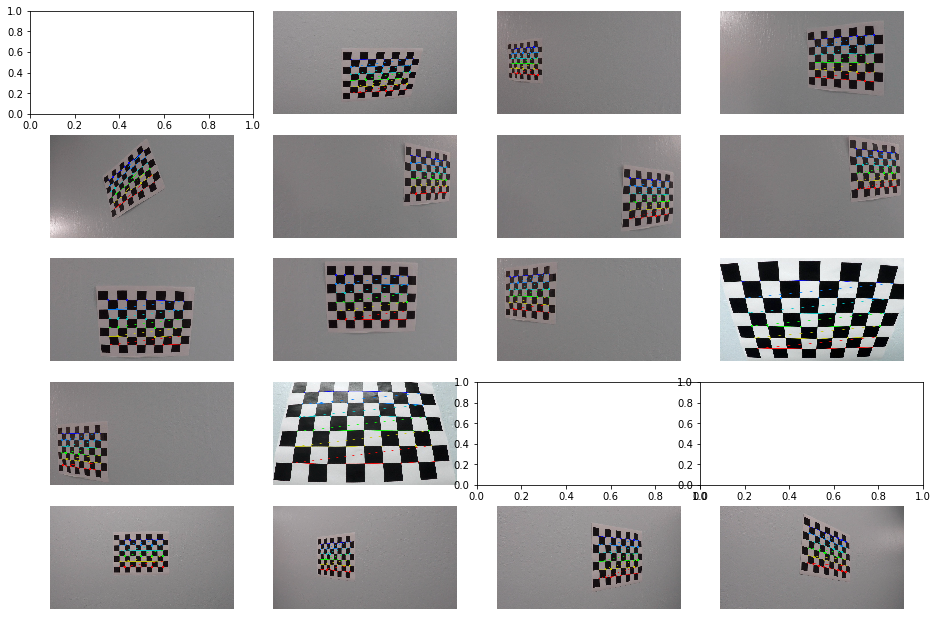

In [23]:
# Prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

fig, axs = plt.subplots(5,4, figsize=(16, 11))
fig.subplots_adjust(hspace = .2, wspace=.001)
axs = axs.ravel()

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners - The tweak here is to use the chess board corners as (9, 6) instead of (8, 6) in lessons
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)
    
    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners. Adjust drawing of chessboard corners to (9,6)
        cv2.drawChessboardCorners(img, (9,6), corners, ret)
        axs[idx].axis('off')
        axs[idx].imshow(img)
#         cv2.imshow('img',img) #Does not work
#         write_name = 'corners_found'+str(idx)+'.jpg'
#         cv2.imwrite(write_name, img)

# Step 3 Calculate Distortion Co-efficients and Test Undistortion on images

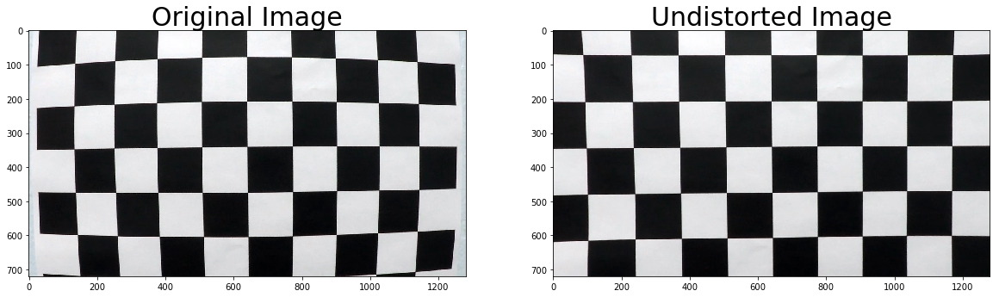

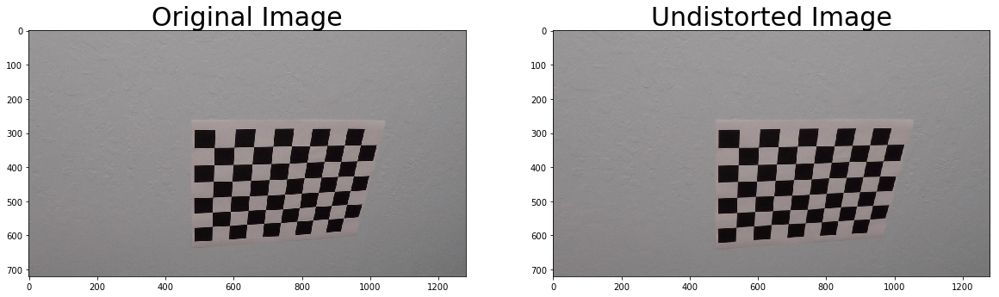

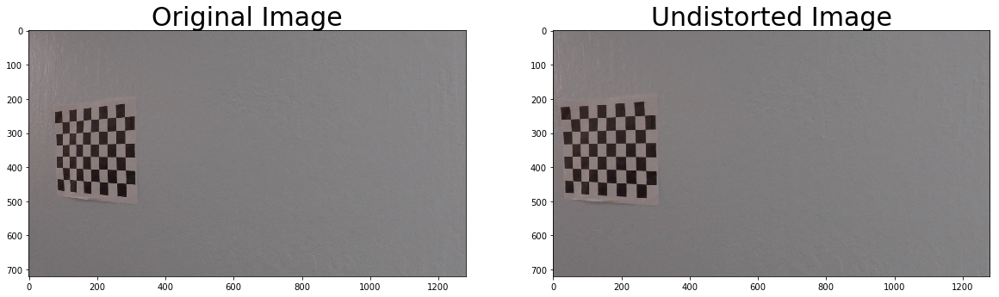

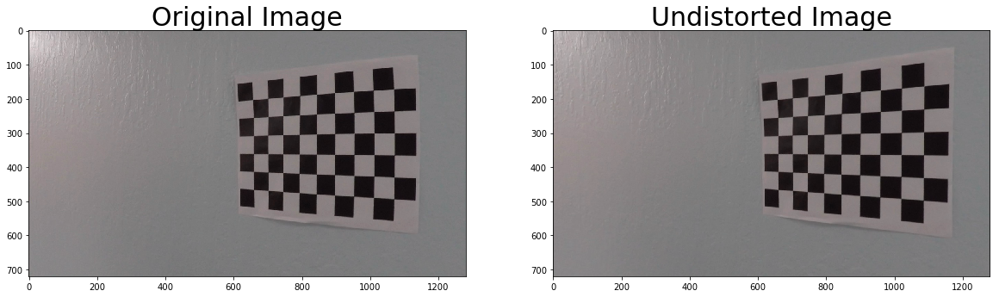

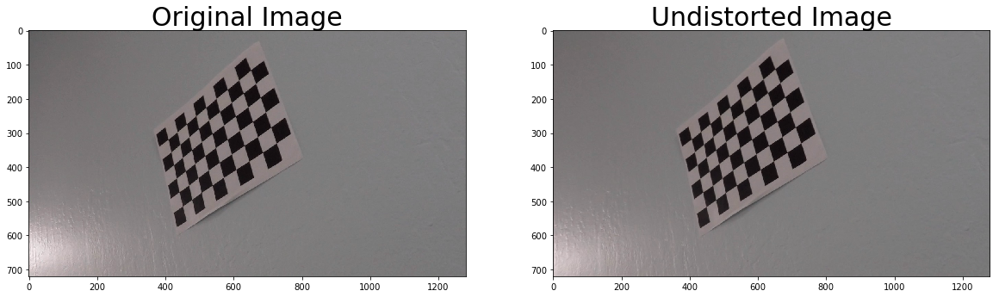

...

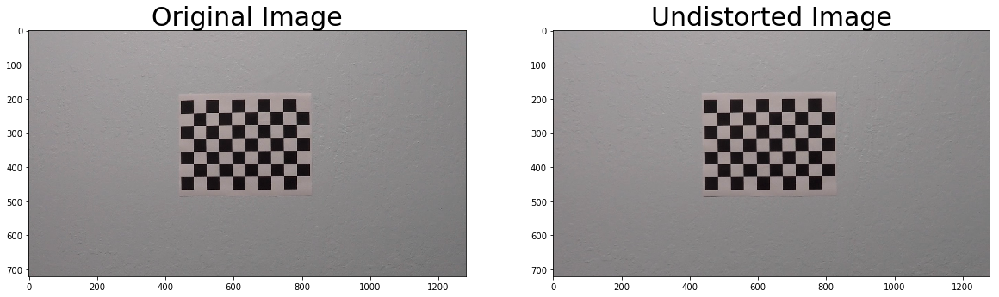

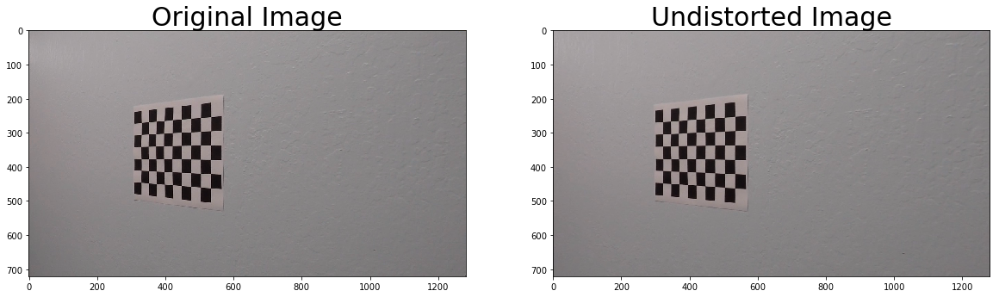

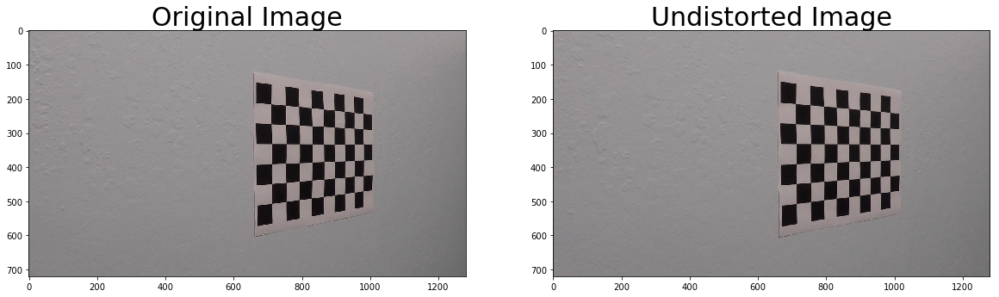

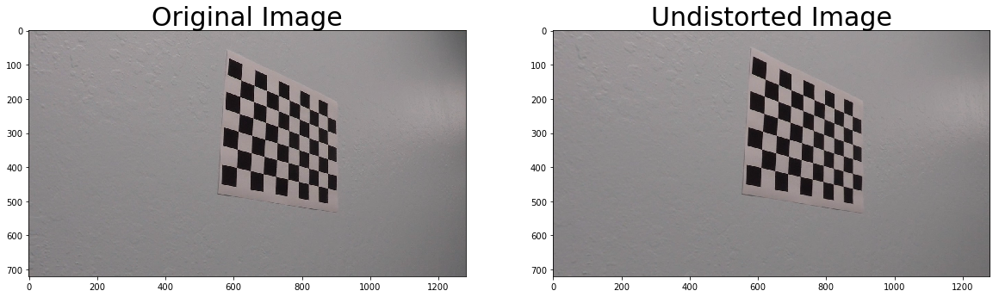

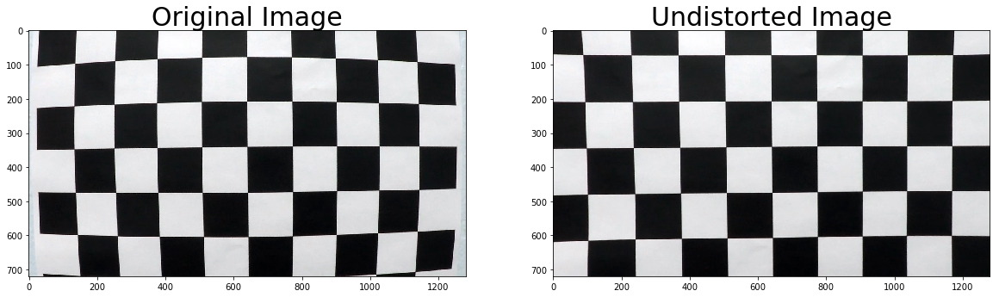

In [29]:
# The technique learnt in the lesson have been applied to all images
# Initialize pickle dictionary
dist_pickle = {}
for idx, fname in enumerate(images):
    # Read each image to undistort
    img = cv2.imread(fname)
    
    #Identify the dimensions
    img_size = (img.shape[1], img.shape[0])
    
    #Calibrate camera
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)
    
    #Undistort images
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    
    #Create a dictionary to dump undistorted image data into a pickle file
#     dist_pickle["mtx"] = mtx
#     dist_pickle["dist"] = dist
    dist_pickle[fname] = mtx
    dist_pickle[fname+"_dist"] = dist
    #dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)

    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(dst)
    ax2.set_title('Undistorted Image', fontsize=30)

#Dump all undistorted images into a pickle file
pickle.dump(dist_pickle, open( "calibration.p", "wb" ))

# Pickle single image calibration for testing purposes
# Test undistortion on an image from Camera Calibration Images folder
img = cv2.imread('./camera_cal/calibration1.jpg')
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)

# Undistort image
dst = cv2.undistort(img, mtx, dist, None, mtx)
# cv2.imwrite('./camera_cal/calibration1_undist.jpg',dst)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "calibration1.p", "wb" ) )
#dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=30)

## Step 4 Applying Undistortion of Images to be tested in Pipeline

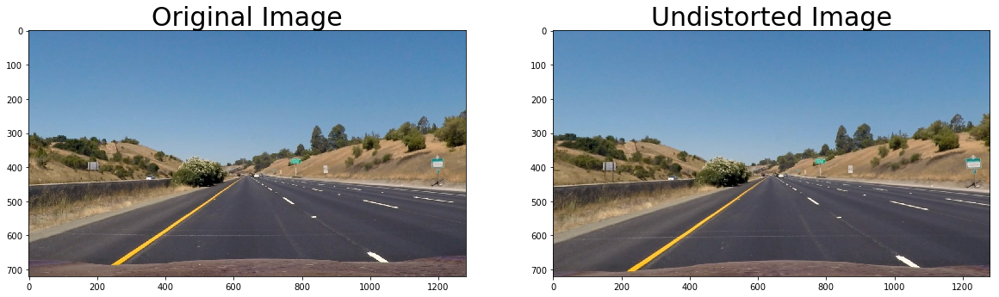

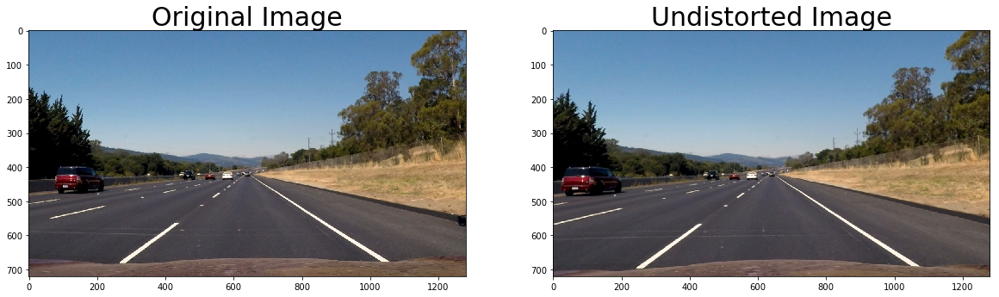

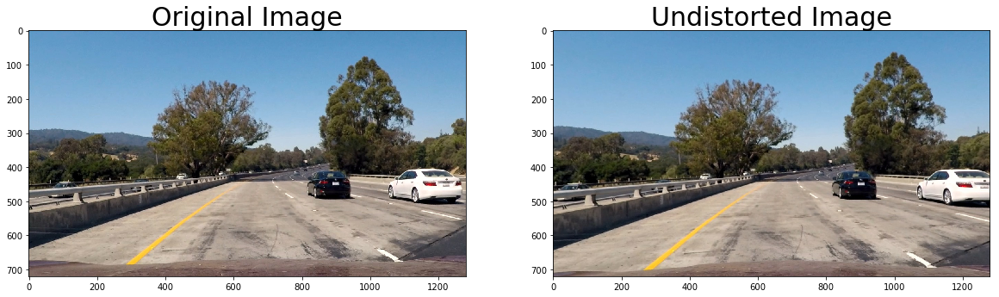

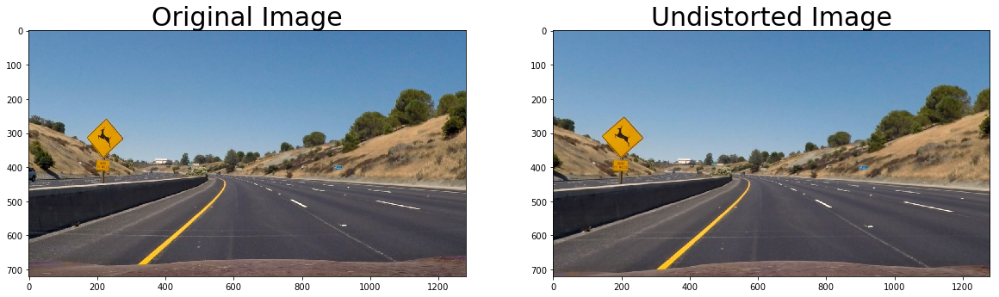

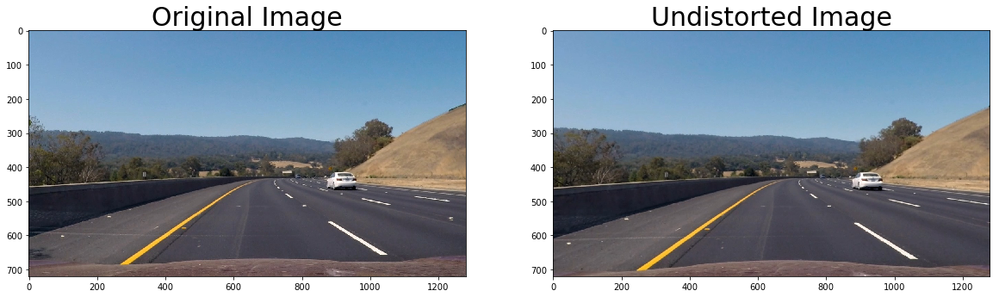

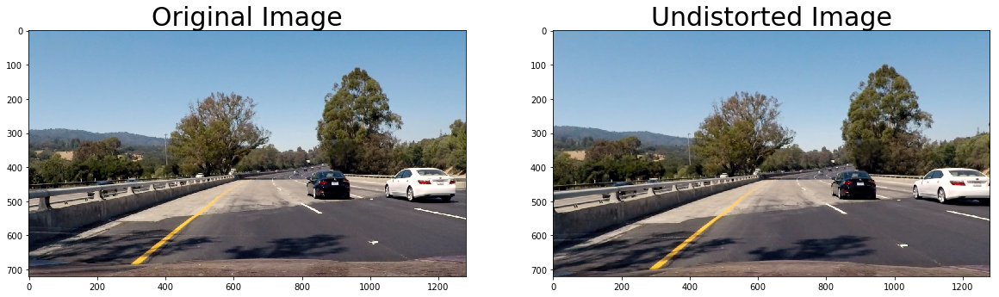

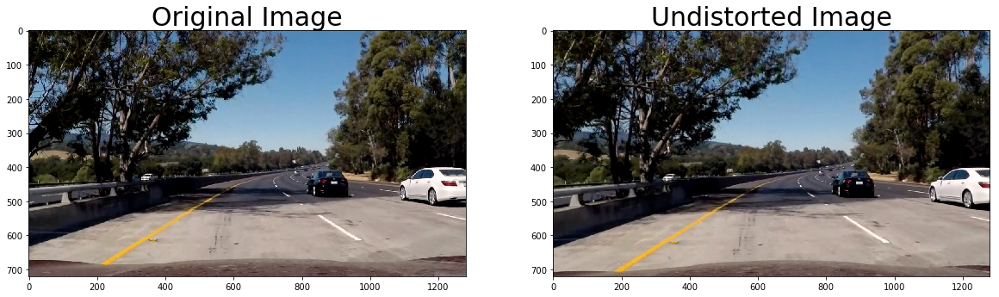

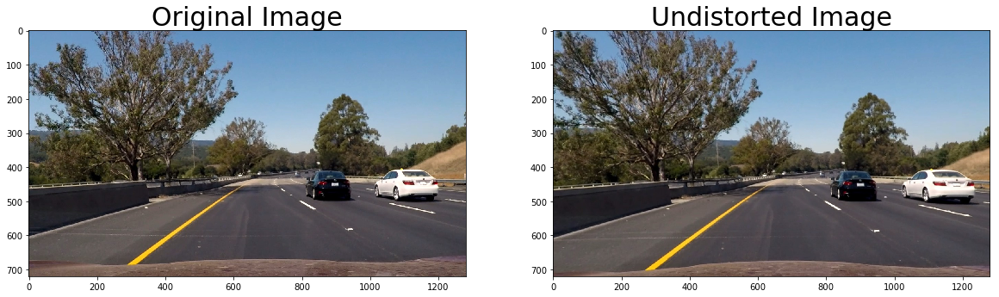

In [52]:
def undistort_image(img):
#     img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    undist_img = cv2.undistort(img, mtx, dist, None, mtx)
    return undist_img


def warp_image(img, src, dst):
    # Compute and apply perpective transform
#     img_size = (img.shape[1], img.shape[0])
    img_size = img.shape[:2]
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST)  # keep same size as input image
    return warped, M, Minv

test_images = glob.glob('./test_images/*.jpg')
for idx, fname in enumerate(test_images):
    test_image = cv2.imread(fname)
    test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)
    undist_image = undistort_image(test_image)    
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(test_image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(undist_image)
    ax2.set_title('Undistorted Image', fontsize=30)
    #Saving Undistorted Images for next step of processing
    cv2.imwrite('./output_images/test'+str(idx)+'_undist.jpg',undist_image)

## Step 5 Applying Perspective Transform

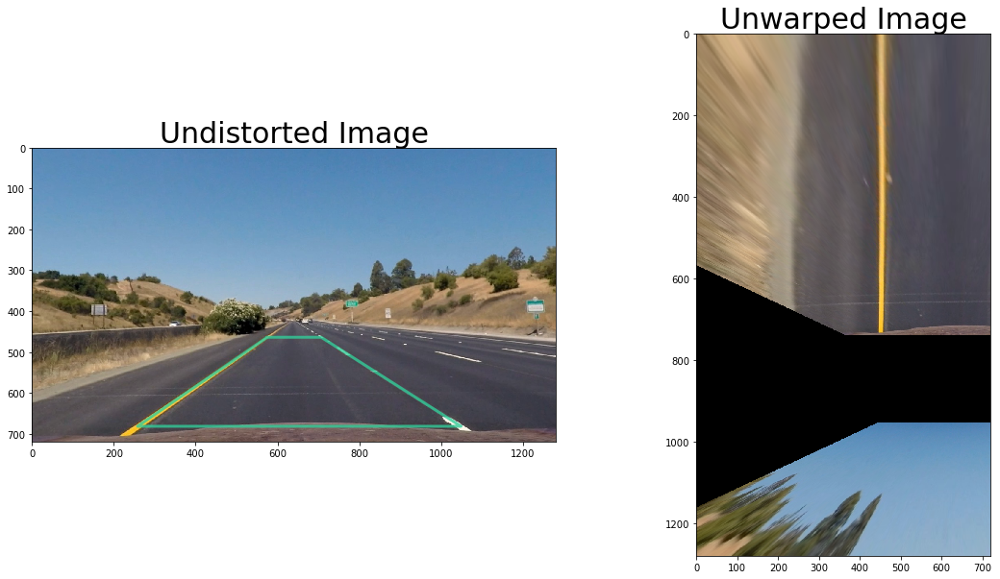

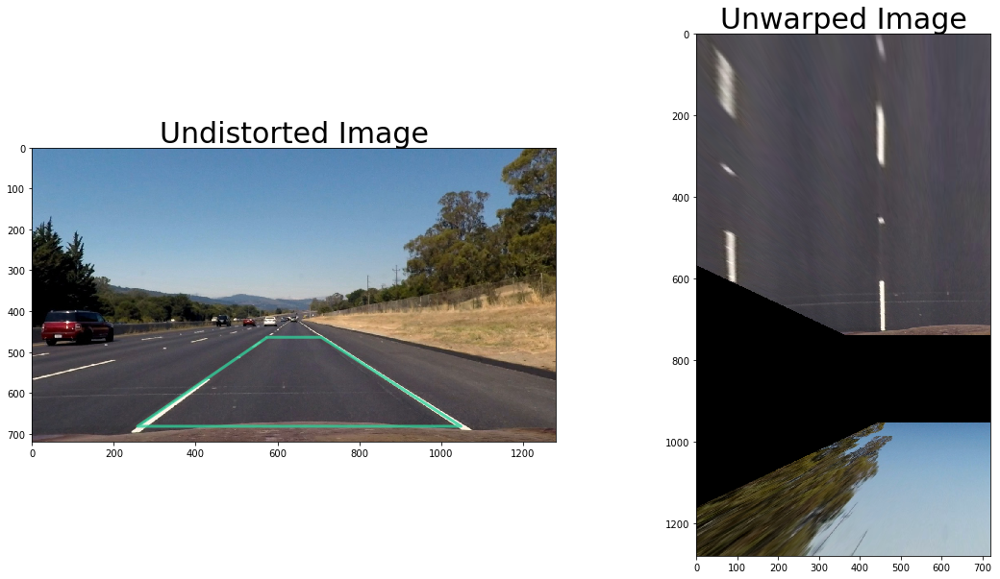

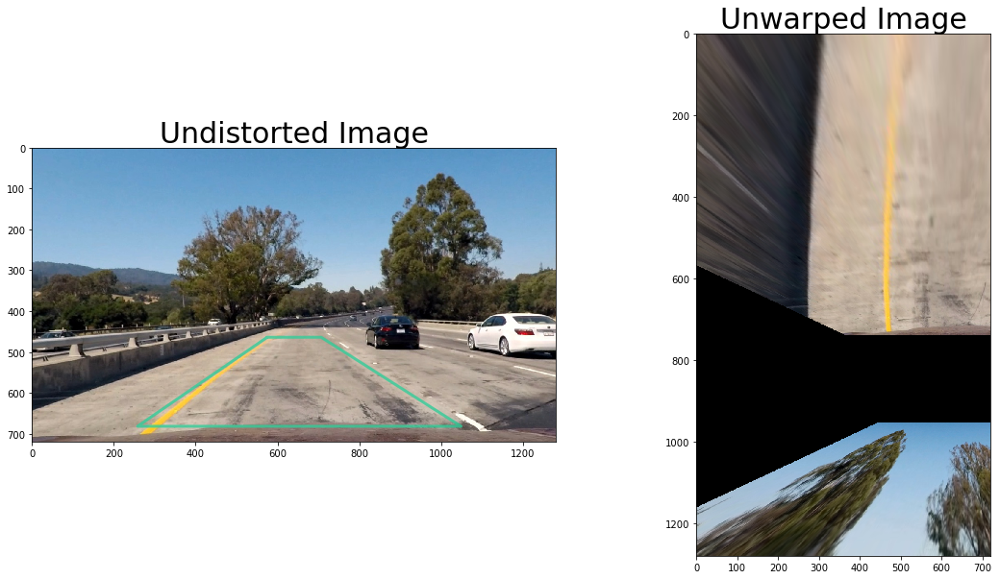

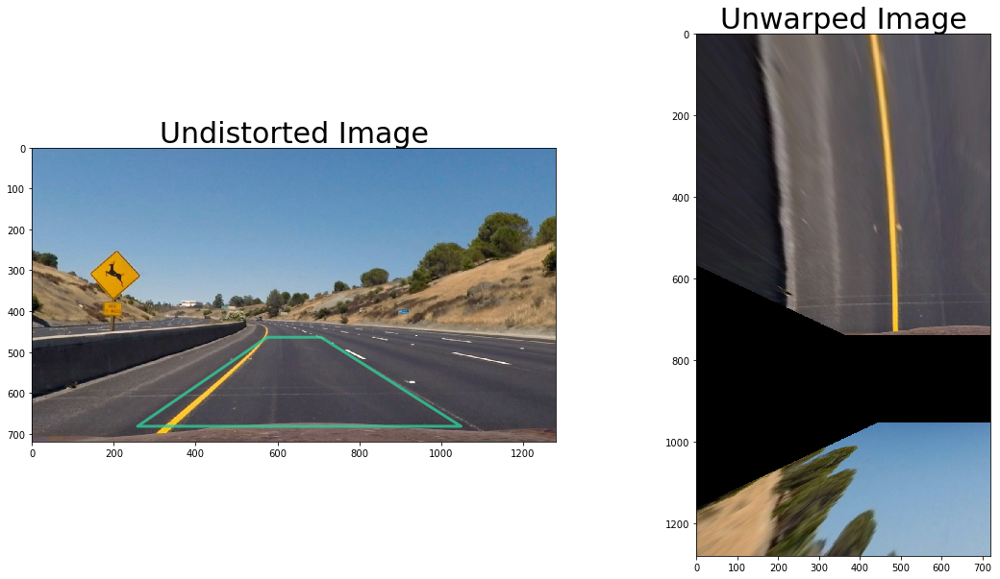

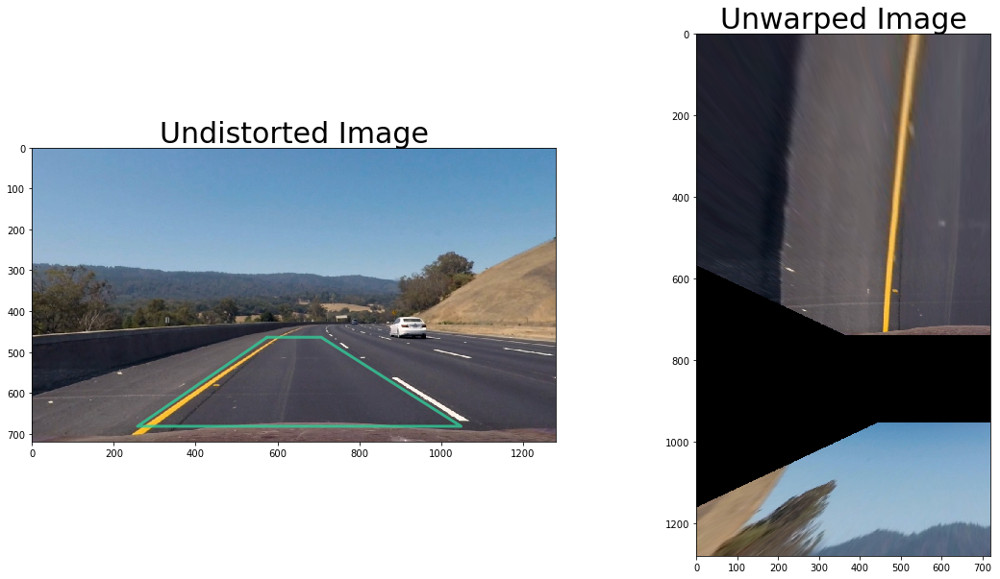

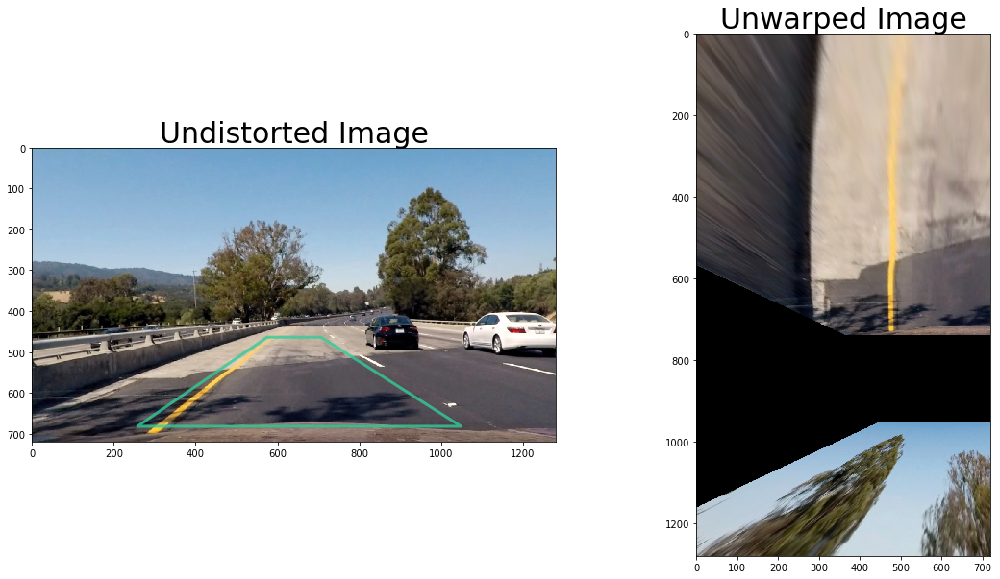

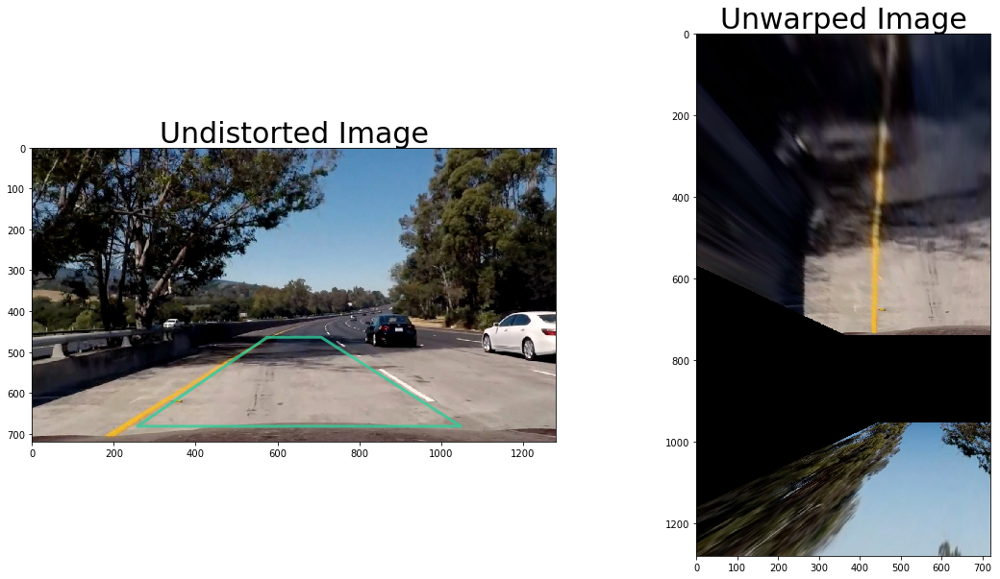

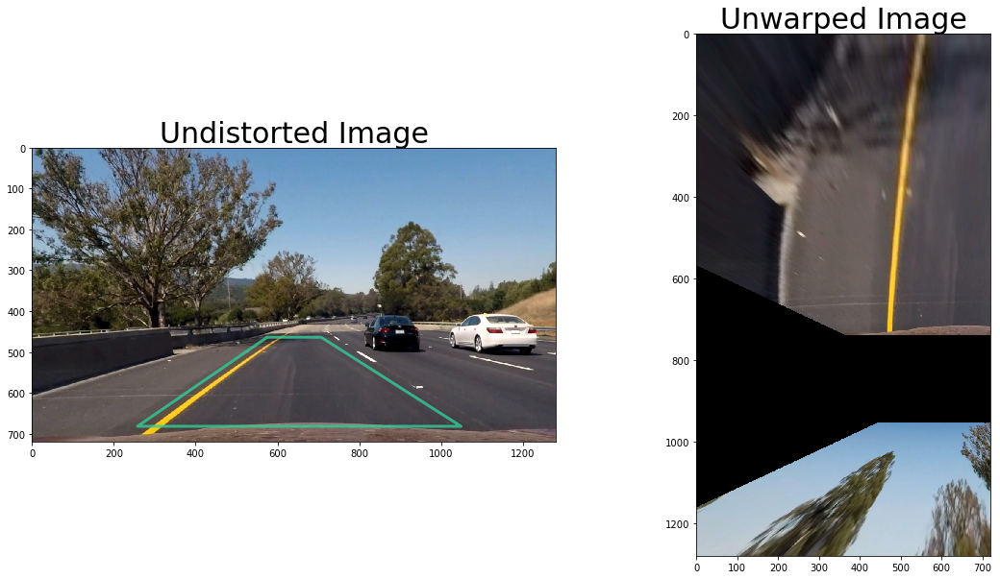

In [75]:
def corners_unwarp(img, nx, ny, mtx, dist):
    # Pass in your image into this function
    # Write code to do the following steps
    # 1) Undistort using mtx and dist
    # 2) Convert to grayscale
    # 3) Find the chessboard corners
    # 4) If corners found: 
            # a) draw corners
            # b) define 4 source points src = np.float32([[,],[,],[,],[,]])
                 #Note: you could pick any four of the detected corners 
                 # as long as those four corners define a rectangle
                 #One especially smart way to do this would be to use four well-chosen
                 # corners that were automatically detected during the undistortion steps
                 #We recommend using the automatic detection of corners in your code
            # c) define 4 destination points dst = np.float32([[,],[,],[,],[,]])
            # d) use cv2.getPerspectiveTransform() to get M, the transform matrix
            # e) use cv2.warpPerspective() to warp your image to a top-down view
    #delete the next two lines
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)
    if ret == True:
        print(corners)
        cv2.drawChessboardCorners(undist, (nx, ny), corners, ret)
        offset = 100
        img_size = (gray.shape[1], gray.shape[0])
        src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
        dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
                                     [img_size[0]-offset, img_size[1]-offset], 
                                     [offset, img_size[1]-offset]])
        M=cv2.getPerspectiveTransform(src,dst)
        Minv=cv2.getPerspectiveTransform(dst,src)
        warped=cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return warped, M, Minv

def warp_image(img, src, dst):
    # Compute and apply perpective transform
#     img_size = (img.shape[1], img.shape[0])
    h, w = img.shape[:2]
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
#     warped = cv2.warpPerspective(img, M, (h, w), flags=cv2.INTER_NEAREST)  # keep same size as input image
    warped = cv2.warpPerspective(img, M, (h, w), flags=cv2.INTER_LINEAR)  # keep same size as input image    
    return warped, M, Minv

def find_polygon(xsize, ysize):
    point1 = (int(xsize*0.11),int(ysize))
    print(point1)
    point2 = (int(xsize*0.44),int(ysize*0.60))
    print(point2)
    point3 = (int(xsize*0.57),int(ysize*0.60))
    print(point3)
    point4 = (int(xsize*0.97),int(ysize))
    print(point4)
    return([point1,point2,point3,point4])

# undist_example = cv2.imread('./output_images/test0_undist.jpg')
# h,w = exampleImg_undistort.shape[:2]

# define source and destination points for transform
src = np.float32([(575,464),
                  (707,464), 
                  (258,682), 
                  (1049,682)])
# dst = np.float32([(450,0),
#                   (w-450,0),
#                   (450,h),
#                   (w-450,h)])

# exampleImg_unwarp, M, Minv = warp_image(exampleImg_undistort, src, dst)

# # Visualize unwarp
# f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
# f.subplots_adjust(hspace = .2, wspace=.05)
# ax1.imshow(undist_example)
# x = [src[0][0],src[2][0],src[3][0],src[1][0],src[0][0]]
# y = [src[0][1],src[2][1],src[3][1],src[1][1],src[0][1]]
# ax1.plot(x, y, color='#33cc99', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)
# ax1.set_ylim([h,0])
# ax1.set_xlim([0,w])
# ax1.set_title('Undistorted Image', fontsize=30)
# ax2.imshow(exampleImg_unwarp)
# ax2.set_title('Unwarped Image', fontsize=30)

undistort_test_images = glob.glob('./output_images/test*_undist.jpg')
# test_images = glob.glob('./test_images/*.jpg')
for idx, fname in enumerate(undistort_test_images):
# for idx, fname in enumerate(test_images):
    undist_image = cv2.imread(fname)
    h,w = undist_image.shape[:2]
    dst = np.float32([(450,0),
                  (w-450,0),
                  (450,h),
                  (w-450,h)])
    unwarped_image, M, Minv = warp_image(undist_image, src, dst)
#     unwarped_image, M, Minv = corners_unwarp(undist_image, h, w, mtx, dist)
    # Visualize unwarp
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(undist_image)
    
    #Draw Quadrilateral on the original undistorted image for painting lanes in pipeline
    vertices = find_polygon(h, w)
#     x = [vertices[0][0],vertices[2][0],vertices[3][0],vertices[1][0],vertices[0][0]]
#     y = [vertices[0][1],vertices[2][1],vertices[3][1],vertices[1][1],vertices[0][1]]
#     print('Vertices X:',x)
#     print('Vertices Y:',y)    
    x = [src[0][0],src[2][0],src[3][0],src[1][0],src[0][0]]
    y = [src[0][1],src[2][1],src[3][1],src[1][1],src[0][1]]
#     print('Vertices X:',x)
#     print('Vertices Y:',y)    

    #Draw Quadrilateral
    ax1.plot(x, y, color='#33cc99', alpha=0.8, linewidth=3, solid_capstyle='round', zorder=2)
    ax1.set_ylim([h,0])
    ax1.set_xlim([0,w])
    ax1.set_title('Undistorted Image', fontsize=30)
    ax2.imshow(unwarped_image)
    ax2.set_title('Unwarped Image', fontsize=30)
    cv2.imwrite('./output_images/warp/test_unwarp'+str(idx)+'.jpg', unwarped_image)

## Step 6 Explore Color Channels

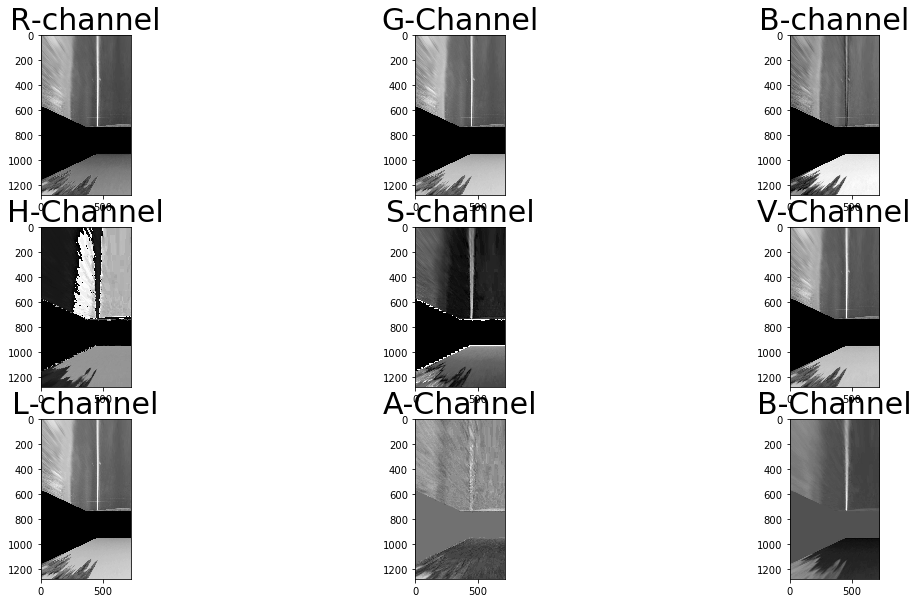

In [81]:
unwarp_image_check = cv2.imread('./output_images/warp/test_unwarp0.jpg')
# Explore RGB Color Channels
unwarp_image_check_R = unwarp_image_check[:,:,0]
unwarp_image_check_G = unwarp_image_check[:,:,1]
unwarp_image_check_B = unwarp_image_check[:,:,2]

#Explore HSV channel
unwarp_image_check_HSV = cv2.cvtColor(unwarp_image_check, cv2.COLOR_RGB2HSV)
unwarp_image_check_H   = unwarp_image_check_HSV[:,:,0]
unwarp_image_check_S   = unwarp_image_check_HSV[:,:,1]
unwarp_image_check_V   = unwarp_image_check_HSV[:,:,2]

#Explore Lab Channel
unwarp_image_check_LAB = cv2.cvtColor(unwarp_image_check, cv2.COLOR_RGB2Lab)
unwarp_image_check_L   = unwarp_image_check_LAB[:,:,0]
unwarp_image_check_A   = unwarp_image_check_LAB[:,:,1]
unwarp_image_check_B2  = unwarp_image_check_LAB[:,:,2]

fig, axs = plt.subplots(3,3, figsize=(20,10))
fig.subplots_adjust(hspace = .2, wspace=.02)
axs = axs.ravel()
axs[0].imshow(unwarp_image_check_R, cmap='gray')
axs[0].set_title('R-channel', fontsize=30)
axs[1].imshow(unwarp_image_check_G, cmap='gray')
axs[1].set_title('G-Channel', fontsize=30)
axs[2].imshow(unwarp_image_check_B, cmap='gray')
axs[2].set_title('B-channel', fontsize=30)
axs[3].imshow(unwarp_image_check_H, cmap='gray')
axs[3].set_title('H-Channel', fontsize=30)
axs[4].imshow(unwarp_image_check_S, cmap='gray')
axs[4].set_title('S-channel', fontsize=30)
axs[5].imshow(unwarp_image_check_V, cmap='gray')
axs[5].set_title('V-Channel', fontsize=30)
axs[6].imshow(unwarp_image_check_L, cmap='gray')
axs[6].set_title('L-channel', fontsize=30)
axs[7].imshow(unwarp_image_check_A, cmap='gray')
axs[7].set_title('A-Channel', fontsize=30)
axs[8].imshow(unwarp_image_check_B2, cmap='gray')
axs[8].set_title('B-Channel', fontsize=30)

## Step 7 Testing thresholds - Absolute, Magnitude, Direction and Color

In [103]:
# Define a function that applies Sobel x and y, 
# then computes the magnitude of the gradient
# and applies a threshold
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # Apply cv2.Sobel()
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1)
    # Take the absolute value of the output from cv2.Sobel()
    abs_sobelx = np.absolute(sobelx)
    # Scale the result to an 8-bit range (0-255)
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    # Apply lower and upper thresholds
    thresh_min = 20
    thresh_max = 100
    # Create binary_output
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    plt.imshow(binary_output, cmap='gray')
    return binary_output

# Define a function to return the magnitude of the gradient
# for a given sobel kernel size and threshold values
def mag_thresh(img, sobel_kernel=20, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output

# Define a function that applies Sobel x and y, 
# then computes the direction of the gradient
# and applies a threshold.
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    # 2) Take the gradient in x and y separately
    # 3) Take the absolute value of the x and y gradients
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    # 5) Create a binary mask where direction thresholds are met
    # 6) Return this mask as your binary_output image
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    abs_sobelx = np.absolute(sobelx) 
    abs_sobely = np.absolute(sobely) 
    graddirection = np.arctan2(abs_sobely, abs_sobelx)
    binary_output = np.zeros_like(graddirection)
    binary_output[(graddirection >= thresh[0]) & (graddirection <= thresh[1])] = 1
    return binary_output

# Define a function that thresholds the S-channel of HLS
# Use exclusive lower bound (>) and inclusive upper (<=)
def hls_select(img, thresh=(0, 255)):
    # 1) Convert to HLS color space
    # 2) Apply a threshold to the S channel
    # 3) Return a binary image of threshold result
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # H = hls[:,:,0]
    # L = hls[:,:,1]
    S = hls[:,:,2] #S Channel picks up lanes well.Robust job.
    # thresh = (90, 255)
    binary_output = np.zeros_like(S)
    binary_output[(S > thresh[0]) & (S <= thresh[1])] = 1
    return binary_output

# Edit this function to create your own pipeline.
def pipeline(img, s_thresh=(170, 255), sx_thresh=(20, 100)):
    img = np.copy(img)
    # Convert to HSV color space and separate the V channel
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hsv[:,:,1]
    s_channel = hsv[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    # Stack each channel
    # Note color_binary[:, :, 0] is all 0s, effectively an all black image. It might
    # be beneficial to replace this channel with something else.
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary))
    return color_binary


## Test Absolute Gradient

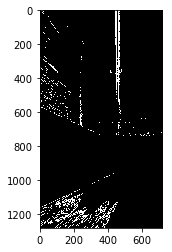

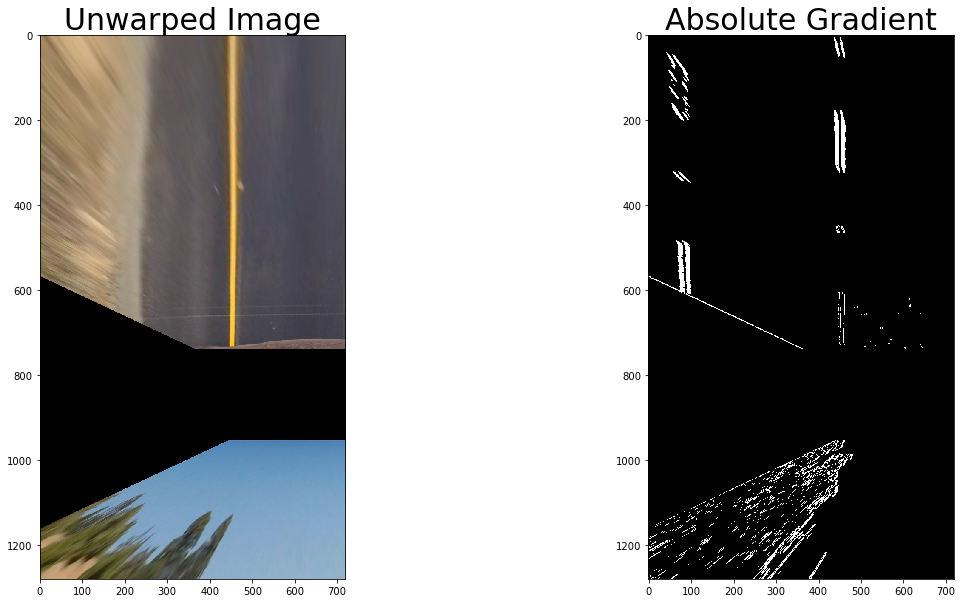

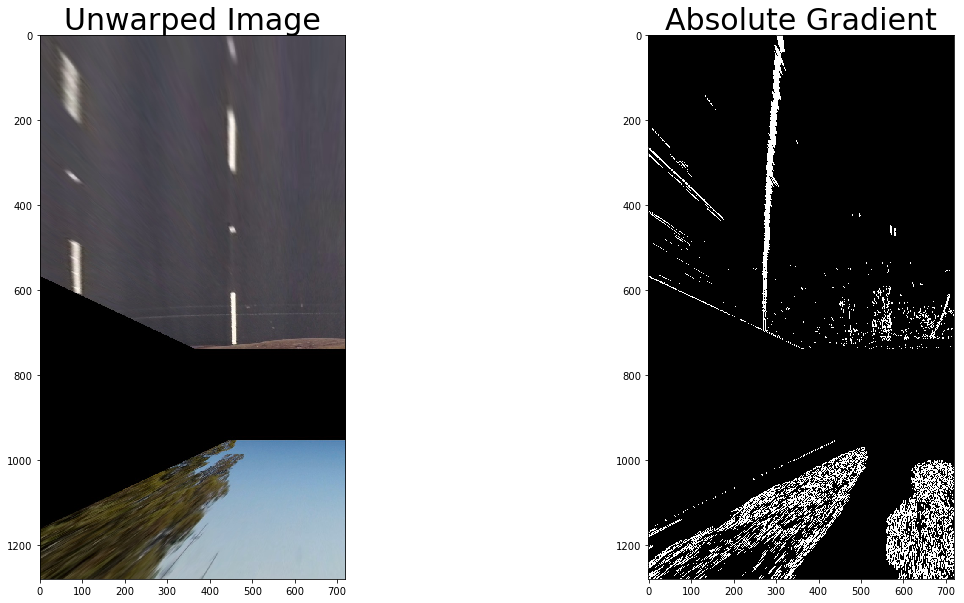

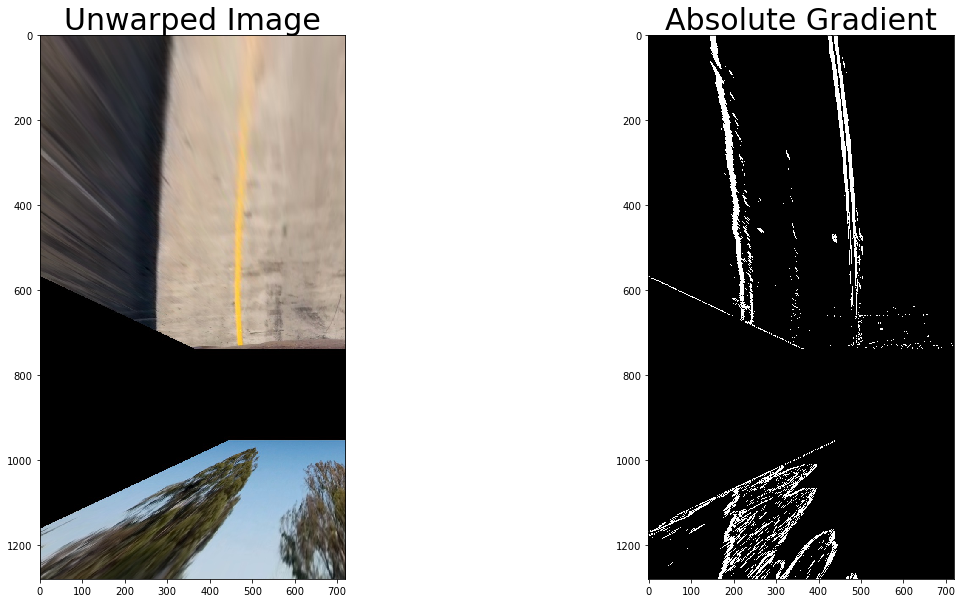

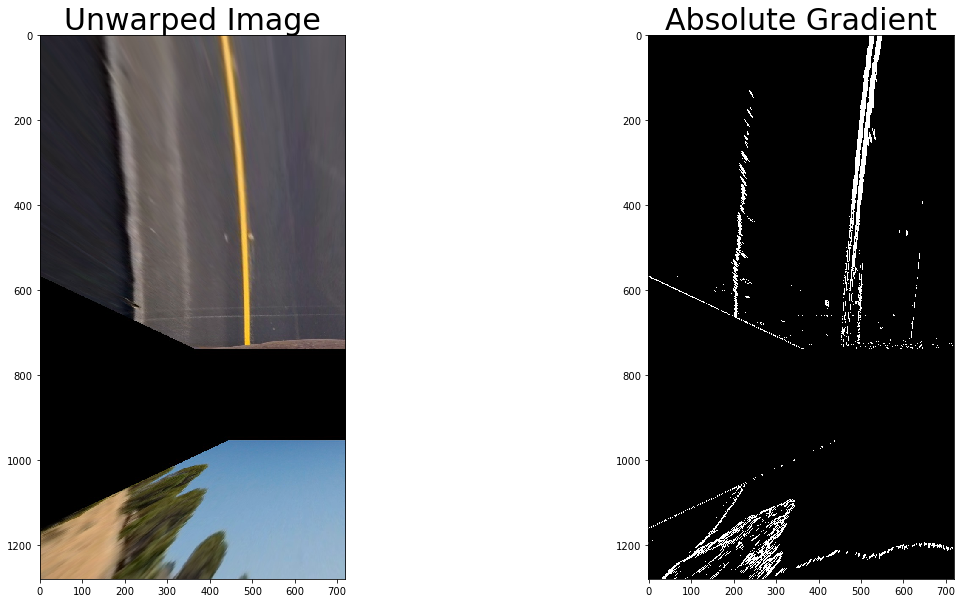

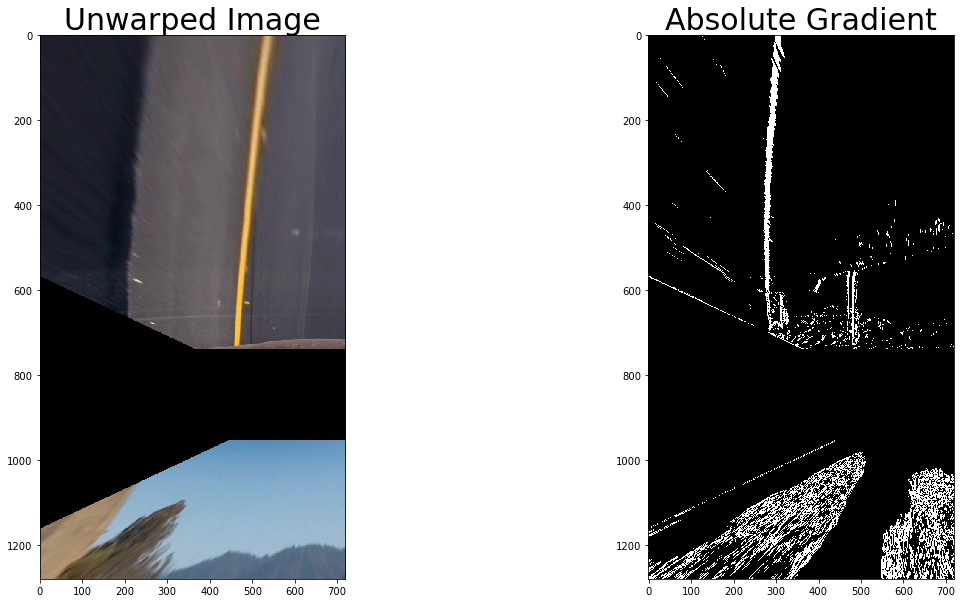

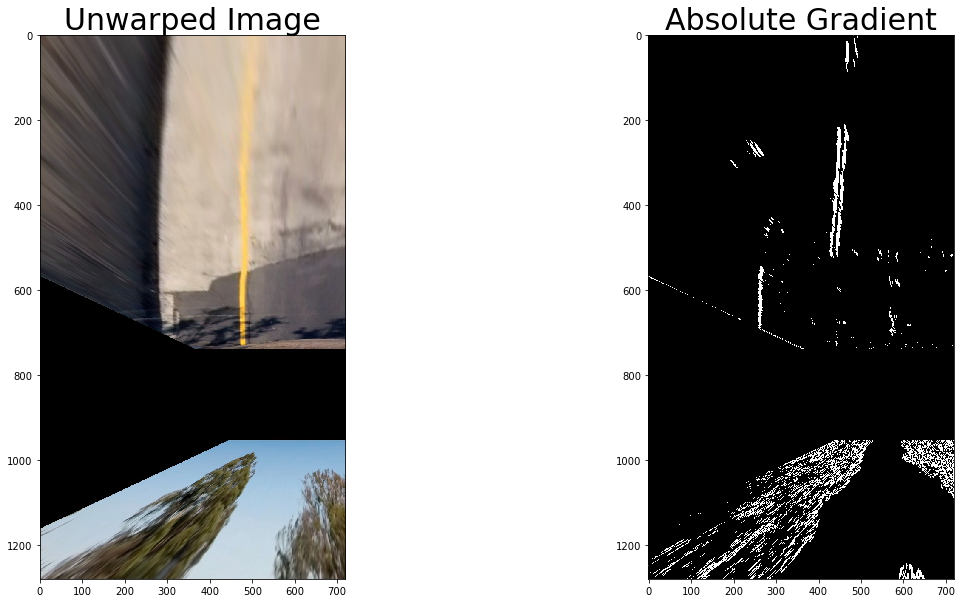

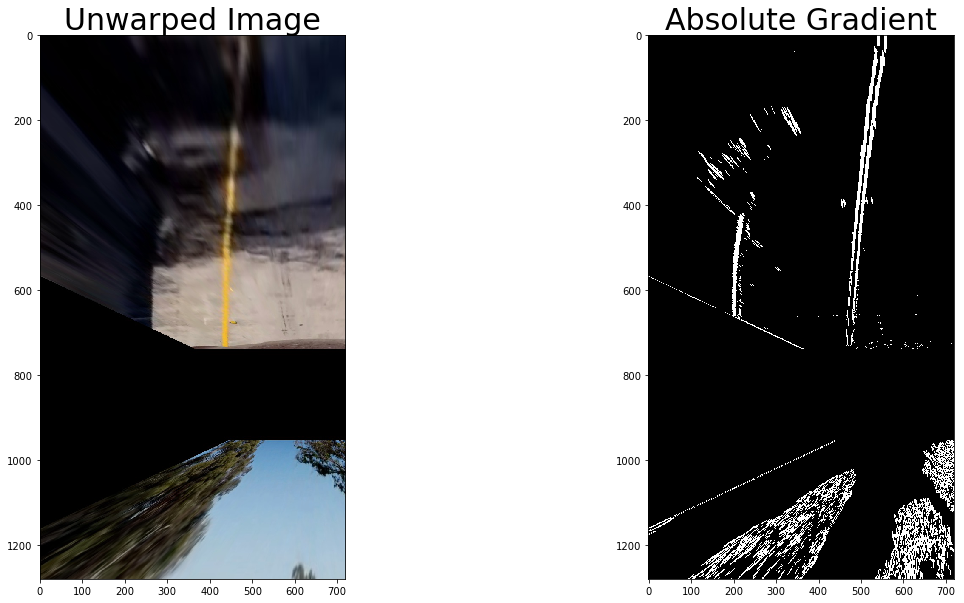

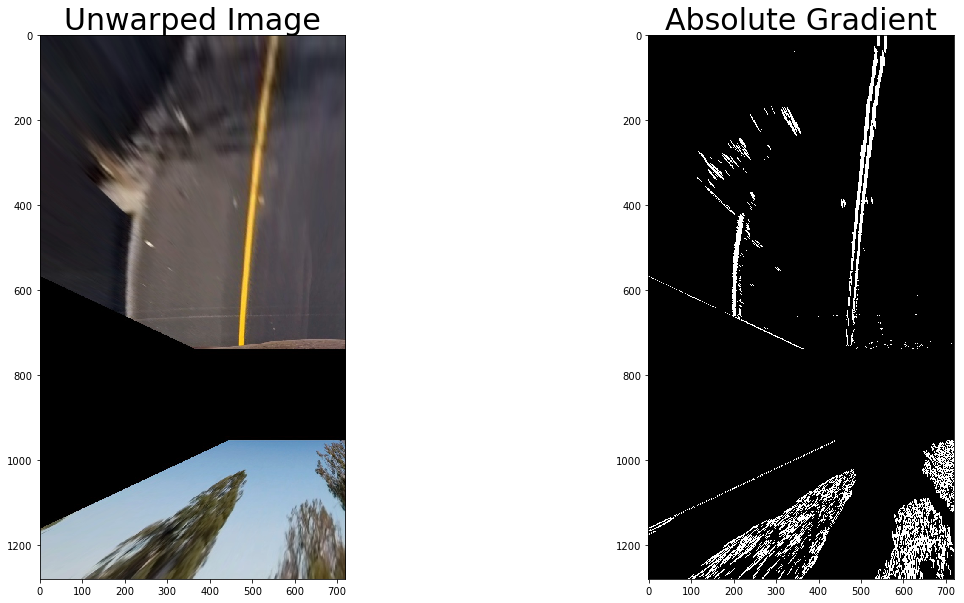

In [104]:
unwarped_test_images = glob.glob('./output_images/warp/*.jpg')

for idx, fname in enumerate(unwarped_test_images):
    # Run the Absolute Threshold function
    unwarp_image = cv2.imread(fname)
    grad_binary = abs_sobel_thresh(unwarp_image, orient='x', thresh_min=0, thresh_max=255)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(unwarp_image)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(grad_binary, cmap='gray')
    ax2.set_title('Absolute Gradient', fontsize=30)

## Test Sobel Magnitude Threshold

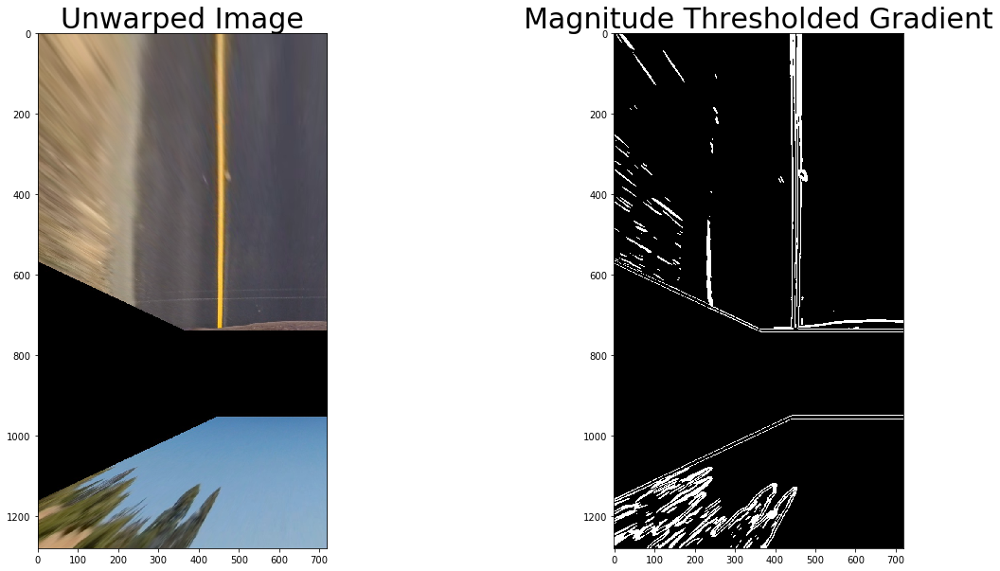

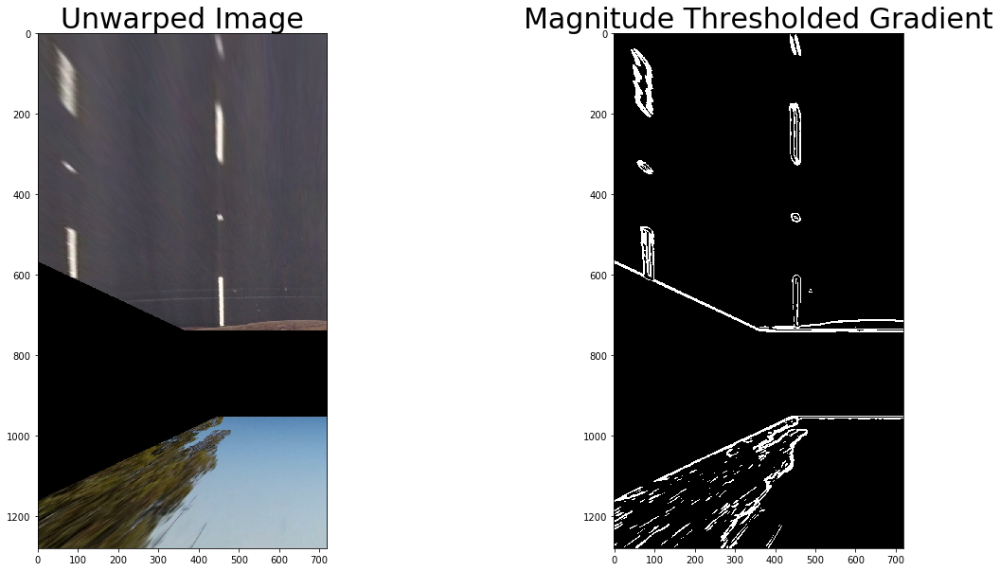

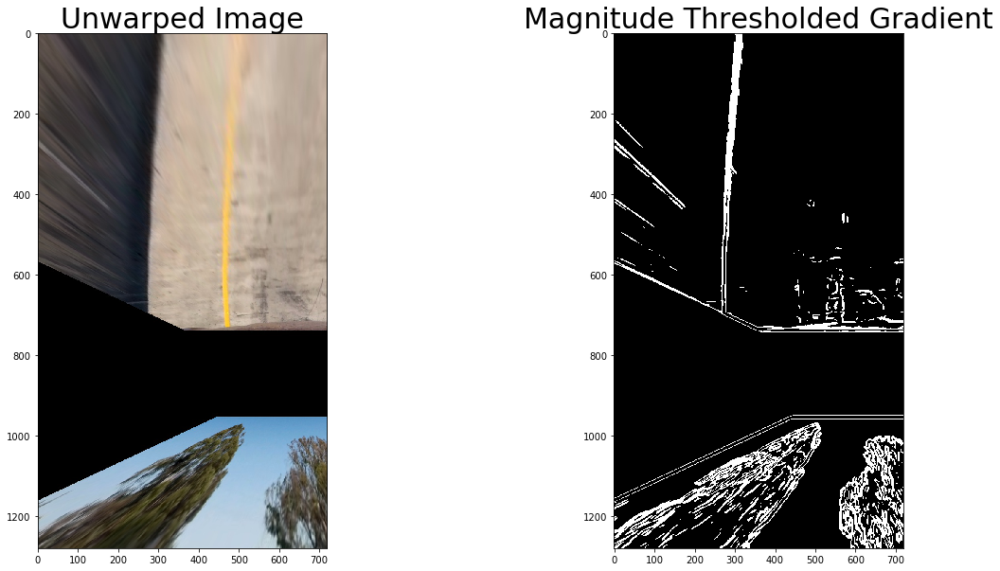

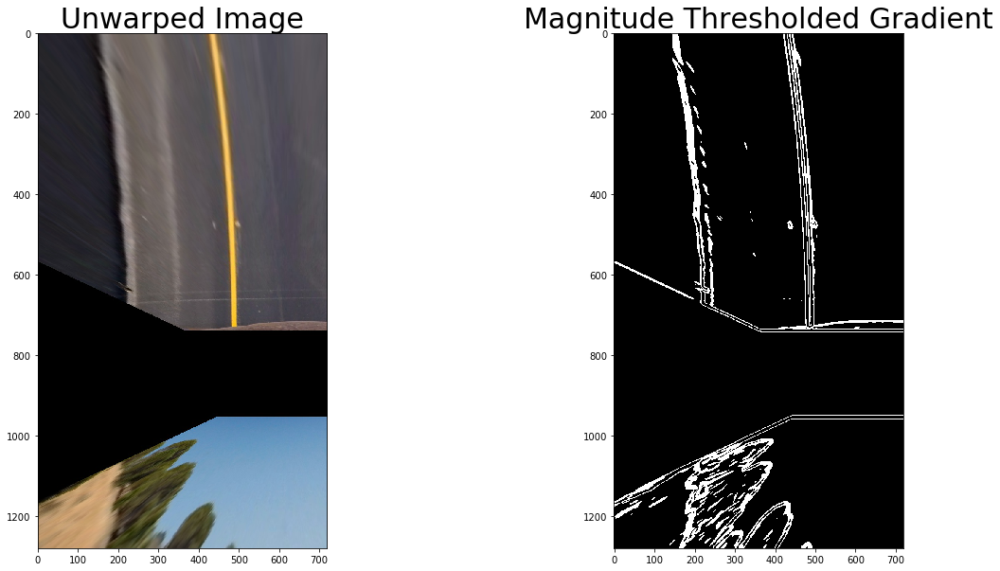

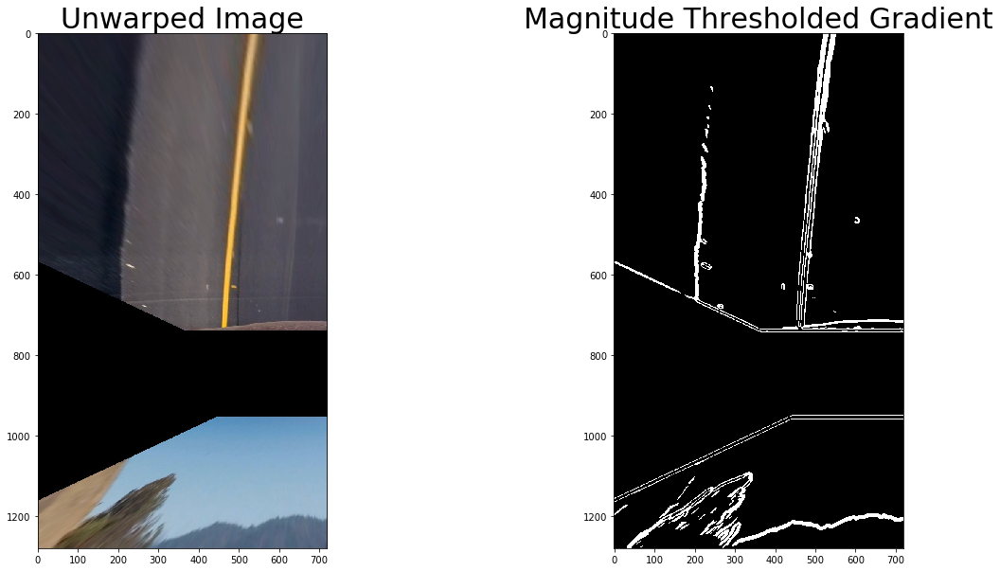

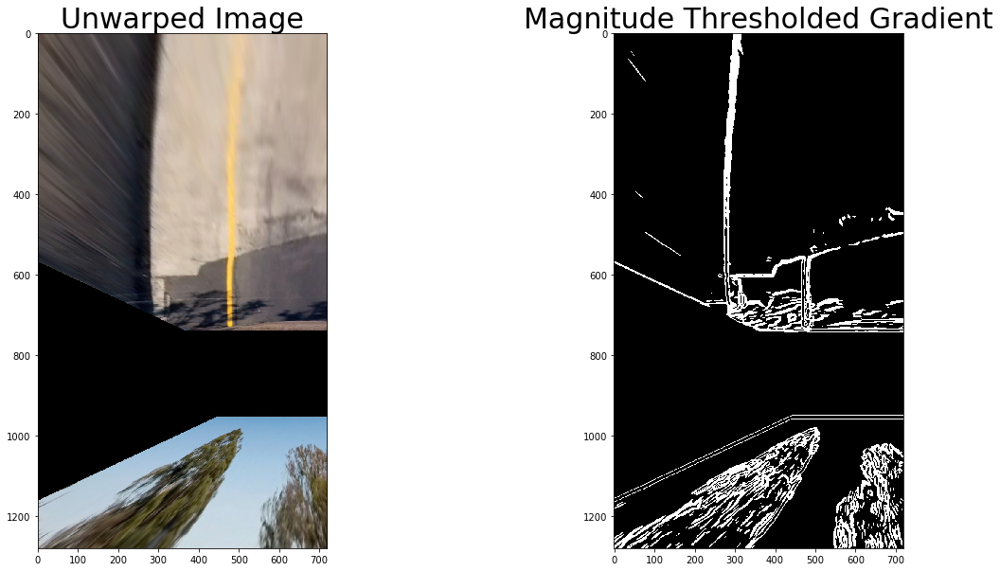

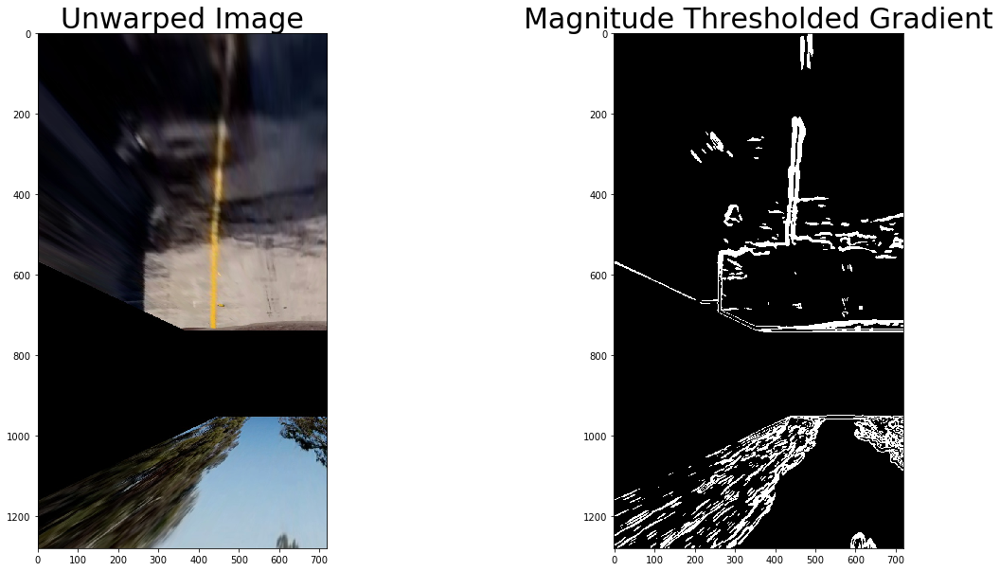

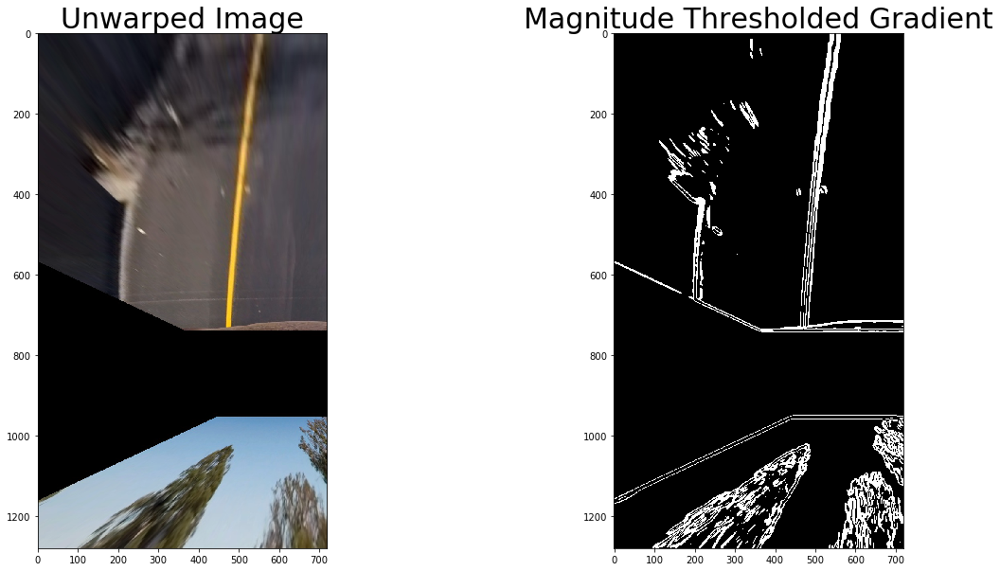

In [105]:
for idx, fname in enumerate(unwarped_test_images):
    # Run the Absolute Threshold function
    unwarp_image = cv2.imread(fname)
    mag_binary = mag_thresh(unwarp_image, sobel_kernel=25, mag_thresh=(30, 100))
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(unwarp_image)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(mag_binary, cmap='gray')
    ax2.set_title('Magnitude Thresholded Gradient', fontsize=30)

## Test Direction Threshold

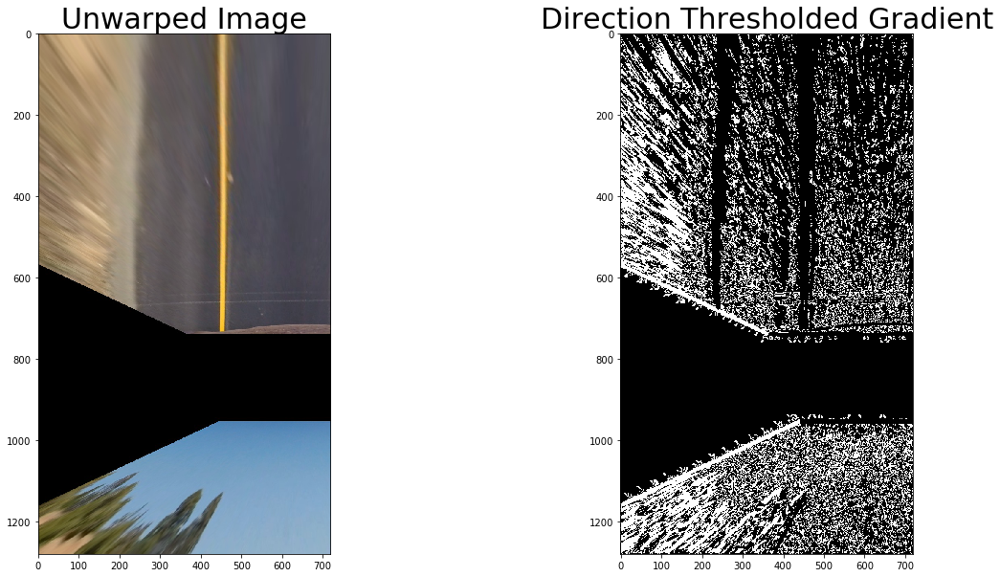

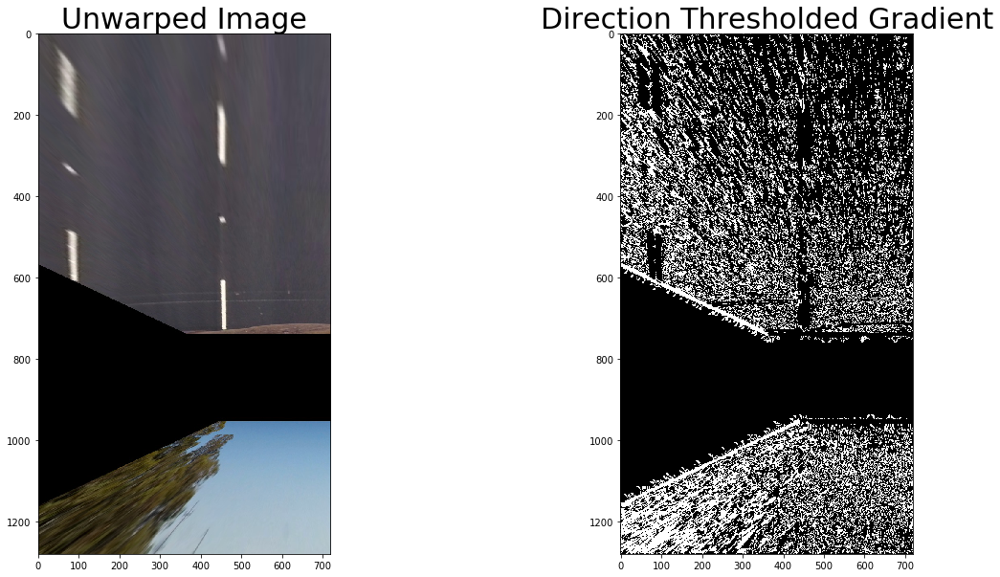

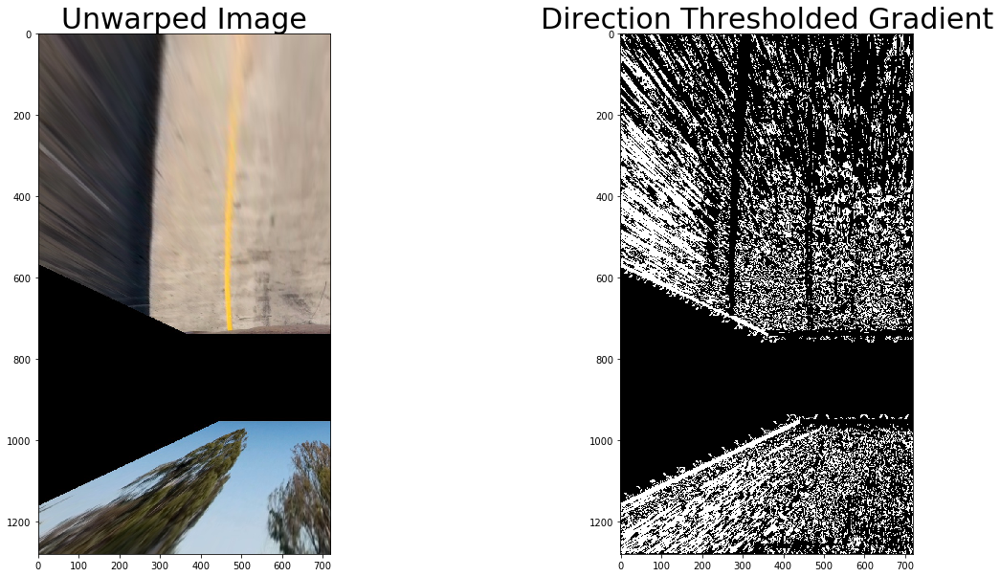

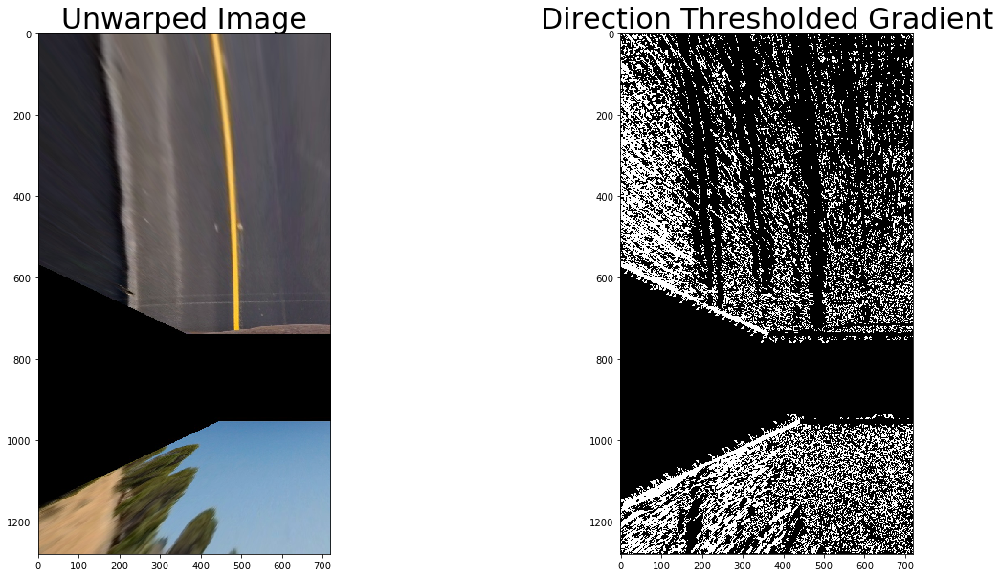

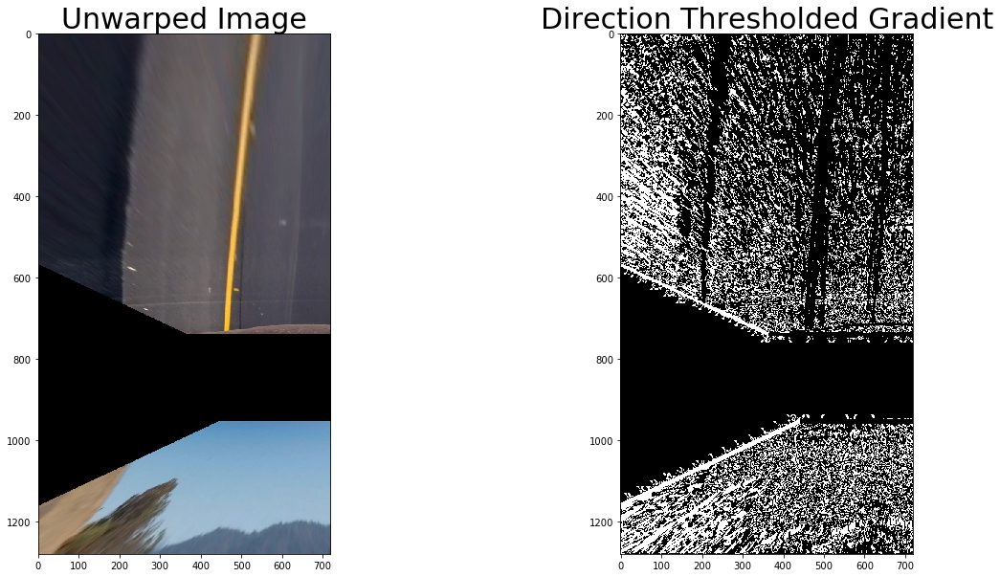

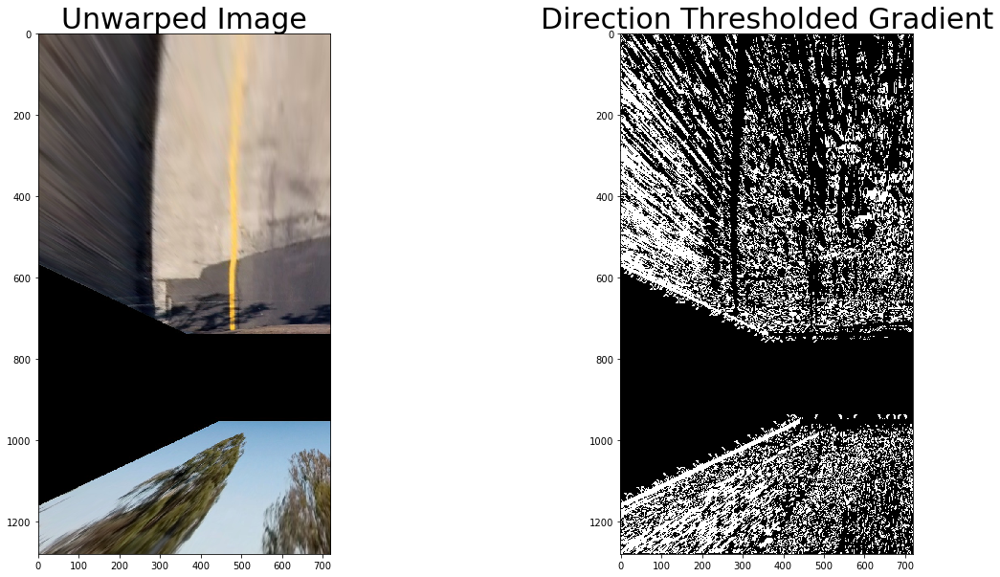

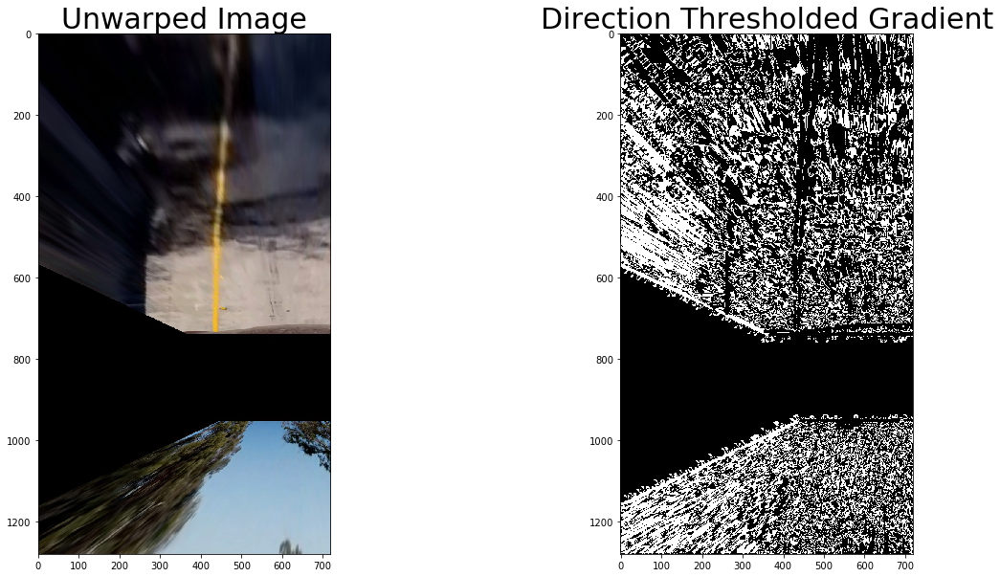

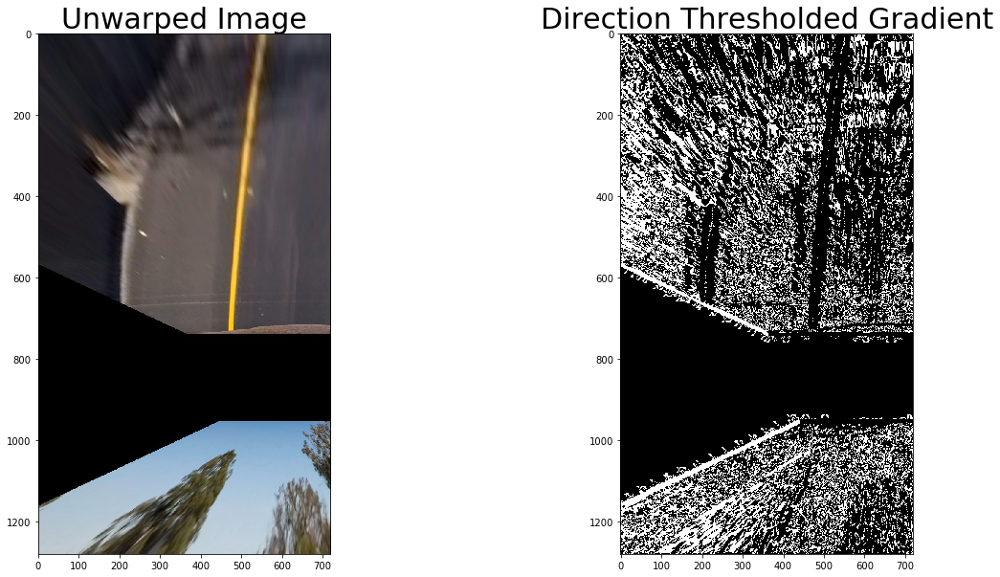

In [106]:
for idx, fname in enumerate(unwarped_test_images):
    # Run the Absolute Threshold function
    unwarp_image = cv2.imread(fname)
    dir_binary = dir_threshold(unwarp_image, sobel_kernel=15, thresh=(0.7, 1.3))
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(unwarp_image)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(dir_binary, cmap='gray')
    ax2.set_title('Direction Thresholded Gradient', fontsize=30)

## Test Color Channel Threshold

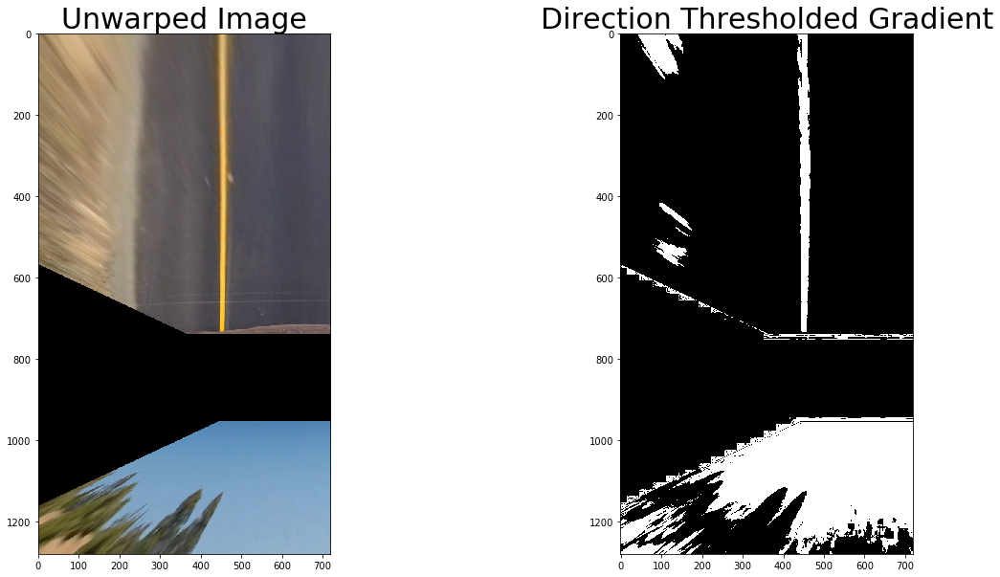

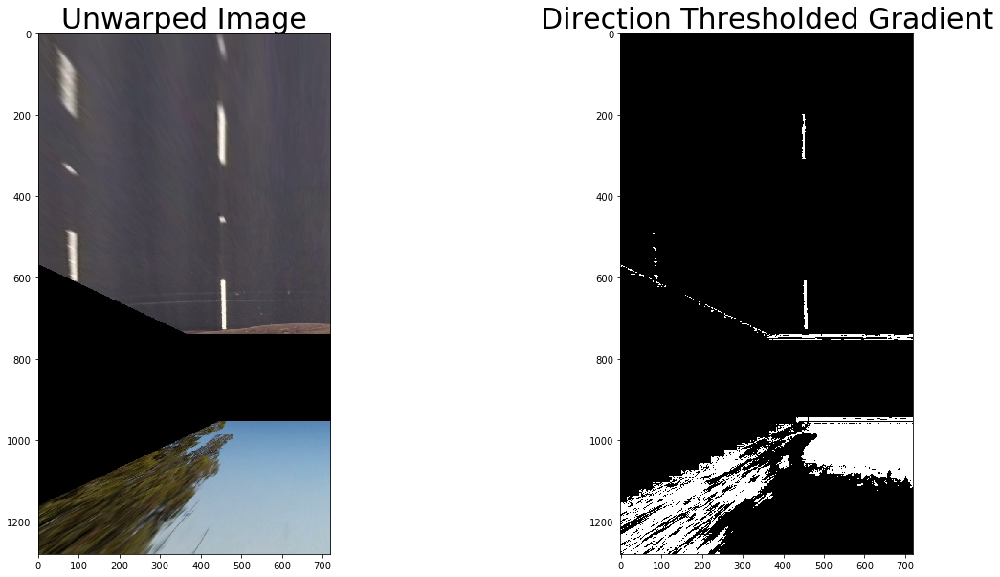

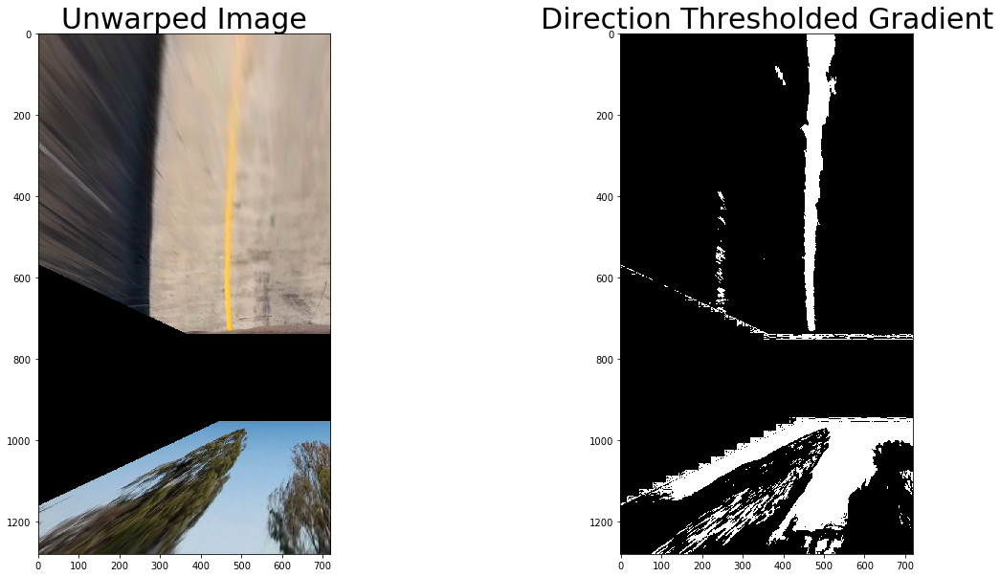

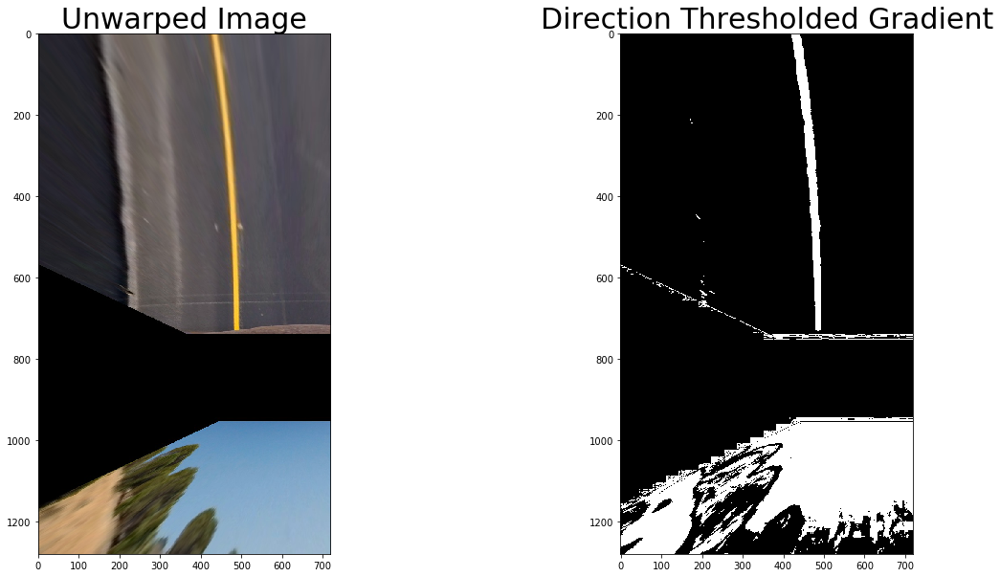

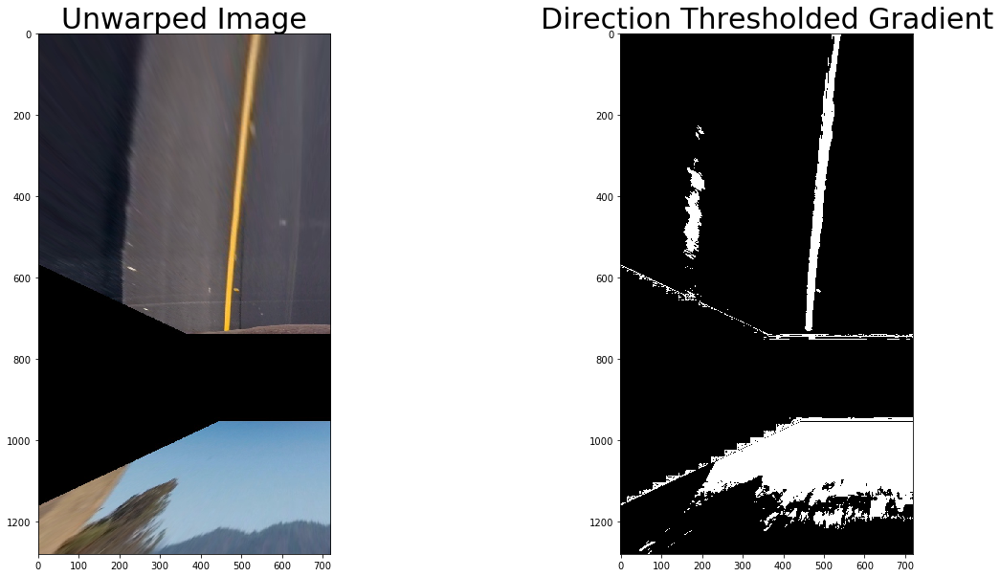

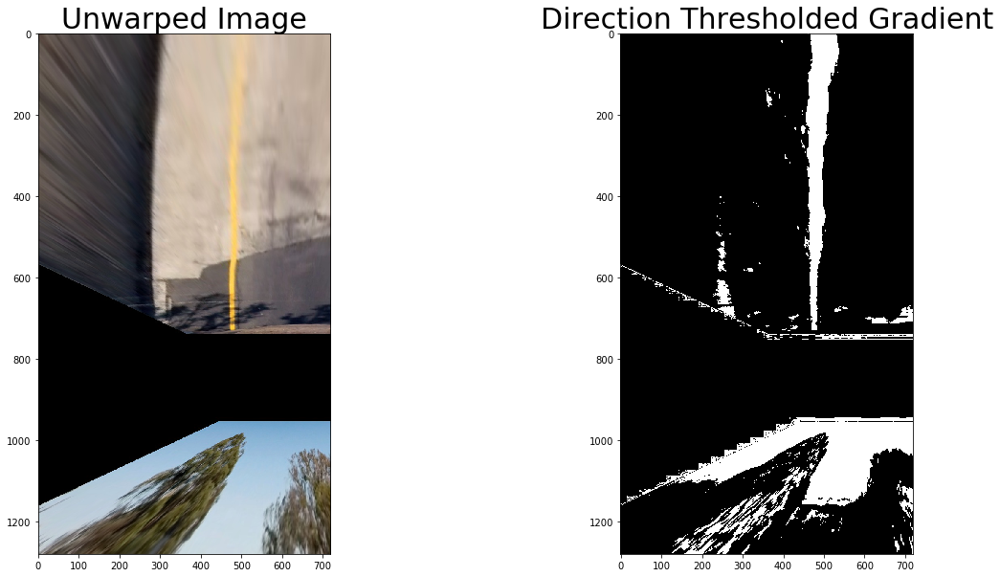

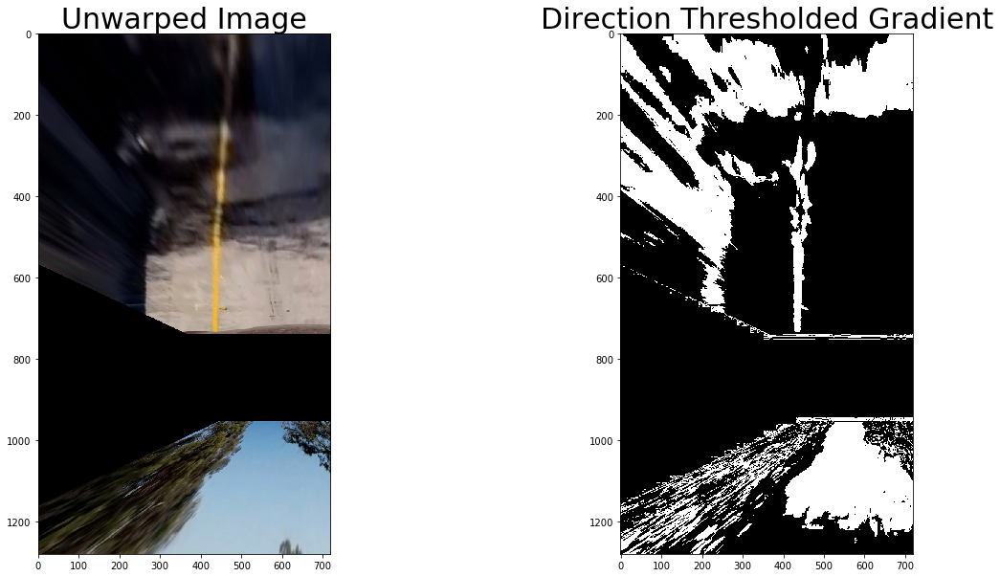

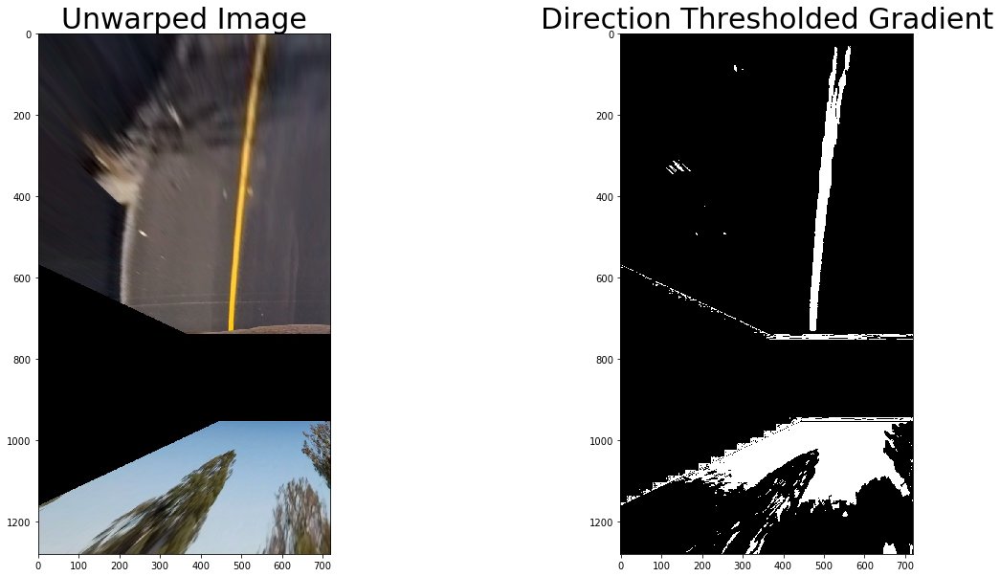

In [107]:
for idx, fname in enumerate(unwarped_test_images):
    # Run the Absolute Threshold function
    unwarp_image = cv2.imread(fname)
    hls_binary = hls_select(unwarp_image, thresh=(90, 255))
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(unwarp_image)
    ax1.set_title('Unwarped Image', fontsize=30)
    ax2.imshow(hls_binary, cmap='gray')
    ax2.set_title('Direction Thresholded Gradient', fontsize=30)

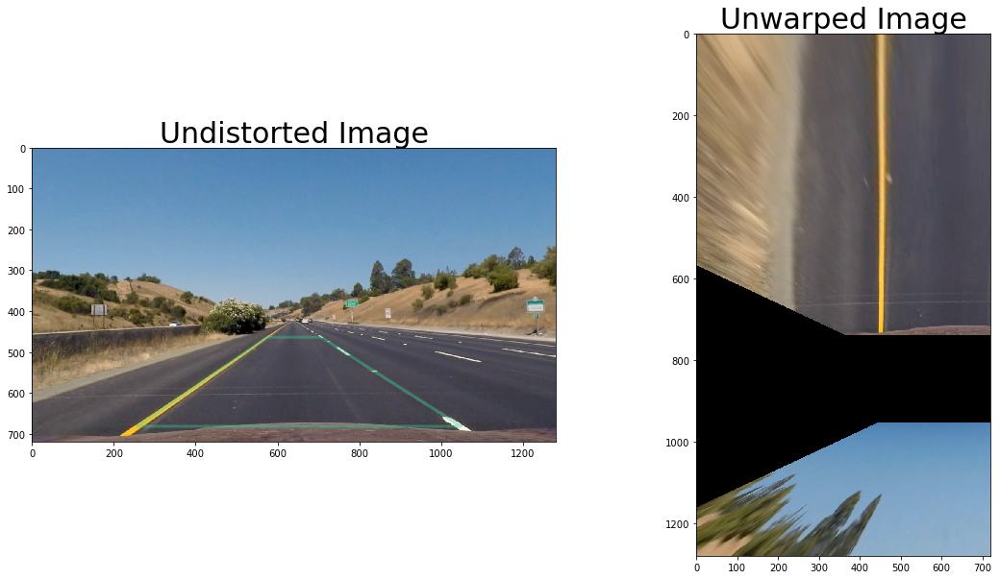

In [27]:
# Assuming you have created a warped binary image called "binary_warped"
# Take a histogram of the bottom half of the image
histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
# Create an output image to draw on and  visualize the result
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
# Find the peak of the left and right halves of the histogram
# These will be the starting point for the left and right lines
midpoint = np.int(histogram.shape[0]/2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

# Choose the number of sliding windows
nwindows = 9
# Set height of windows
window_height = np.int(binary_warped.shape[0]/nwindows)
# Identify the x and y positions of all nonzero pixels in the image
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
# Current positions to be updated for each window
leftx_current = leftx_base
rightx_current = rightx_base
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50
# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []

# Step through the windows one by one
for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = binary_warped.shape[0] - (window+1)*window_height
    win_y_high = binary_warped.shape[0] - window*window_height
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
    # Identify the nonzero pixels in x and y within the window
    good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
    # Append these indices to the lists
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)
    # If you found > minpix pixels, recenter next window on their mean position
    if len(good_left_inds) > minpix:
        leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
    if len(good_right_inds) > minpix:        
        rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

# Concatenate the arrays of indices
left_lane_inds = np.concatenate(left_lane_inds)
right_lane_inds = np.concatenate(right_lane_inds)

# Extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds] 

# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

NameError: name 'binary_warped' is not defined